In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import sunpy
import sunpy.map
from sunpy.coordinates import (get_earth, get_horizons_coord,
                                Helioprojective, propagate_with_solar_surface,
                                HeliocentricEarthEcliptic, get_body_heliographic_stonyhurst)
import sunkit_image
import sunkit_image.coalignment as coalignment
import astropy
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS
import astropy.units as u
import astropy.constants as const
from astropy.io import fits
import eispac
import irispy.io
import pyvista as pv

import cmcrameri.cm as cmcm
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from matplotlib.ticker import (AutoLocator, AutoMinorLocator, 
    FixedLocator, FixedFormatter, LogLocator, StrMethodFormatter)
from ipywidgets import interactive, widgets
from IPython.display import display, clear_output
from astropy.visualization import (AsinhStretch, LinearStretch,
        LogStretch, ImageNormalize)
import os
from sun_blinker import SunBlinker
from copy import deepcopy   


In [2]:
def plot_colorbar(im, ax, width="3%", height="100%",loc="lower left",fontsize=14,
                  bbox_to_anchor=(1.02, 0., 1, 1),orientation="vertical"):
    clb_ax = inset_axes(ax,width=width,height=height,loc=loc,
                bbox_to_anchor=bbox_to_anchor,
                 bbox_transform=ax.transAxes,
                 borderpad=0)
    clb = plt.colorbar(im,pad = 0.05,orientation=orientation,ax=ax,cax=clb_ax)
    clb_ax.yaxis.set_minor_locator(AutoMinorLocator(5))
    clb_ax.yaxis.get_offset_text().set_fontsize(fontsize)
    clb_ax.tick_params(labelsize=fontsize)
    return clb, clb_ax

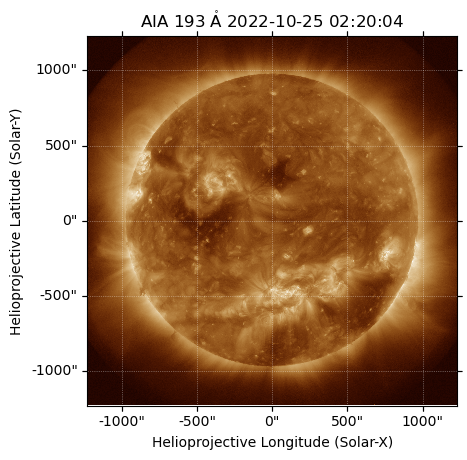

In [3]:
aia_193_map_eis = sunpy.map.Map("../../src/AIA/20221025/193/lvl15/aia.lev1_euv_12s.2022-10-25T022003Z.193.image.fits")
aia_193_map_eis.plot()

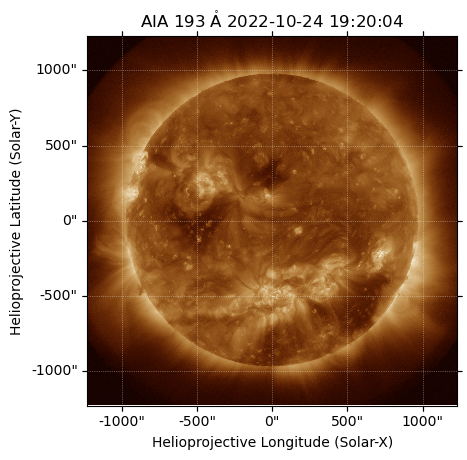

In [4]:
aia_193_map = sunpy.map.Map("../../src/AIA/20221024/193/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.193.image.fits")
aia_193_map.plot()

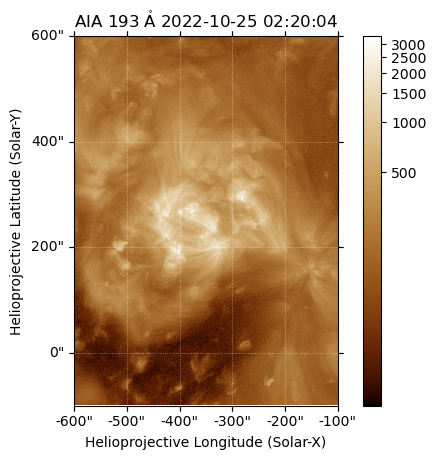

In [5]:
aia_193_map_eis_crop = aia_193_map_eis.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis.coordinate_frame))
aia_193_map_eis_crop.plot()
plt.colorbar()

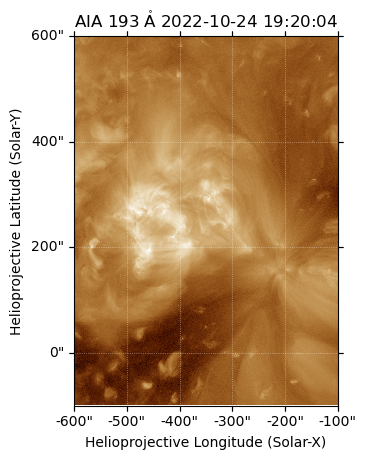

In [6]:
aia_193_map_crop = aia_193_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map.coordinate_frame))
aia_193_map_crop.plot()

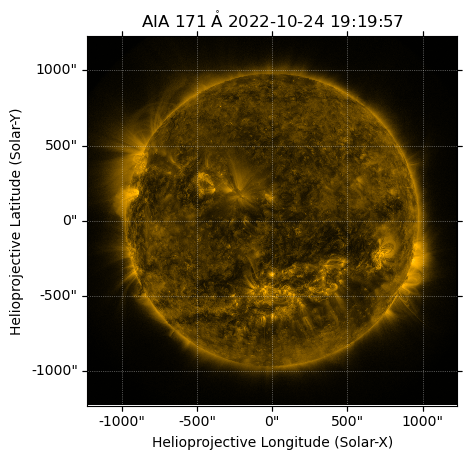

In [7]:
aia_171_map = sunpy.map.Map("../../src/AIA/20221024/171/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.171.image.fits")
aia_171_map.plot()

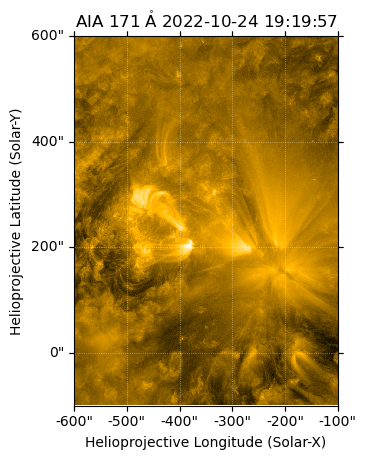

In [8]:
aia_171_map_crop = aia_171_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_171_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_171_map.coordinate_frame))
aia_171_map_crop.plot()

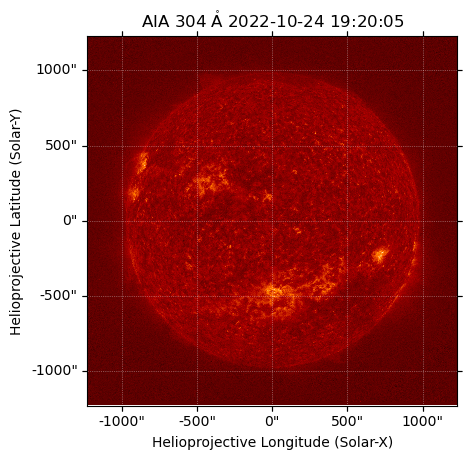

In [9]:
aia_304_map = sunpy.map.Map("../../src/AIA/20221024/304/lvl15/aia.lev1_euv_12s.2022-10-24T192003Z.304.image.fits")
aia_304_map.plot()

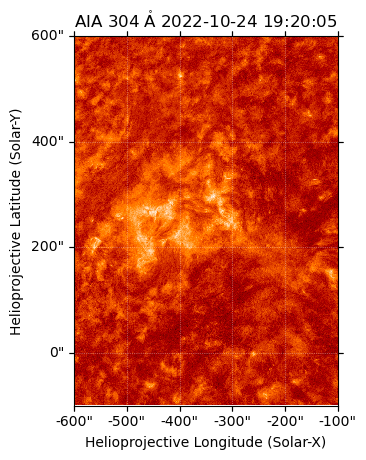

In [10]:
aia_304_map_crop = aia_304_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_304_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_304_map.coordinate_frame))
aia_304_map_crop.plot()

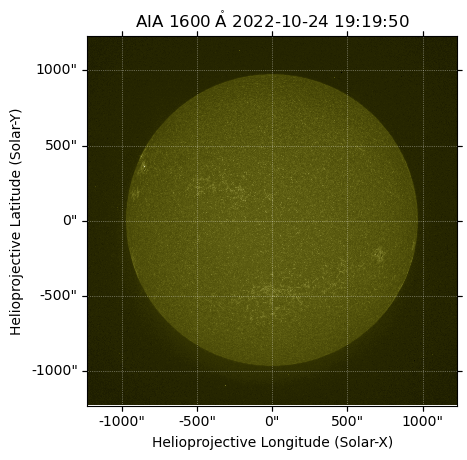

In [11]:
aia_1600_map = sunpy.map.Map("../../src/AIA/20221024/1600/lvl15/aia.lev1_uv_24s.2022-10-24T191951Z.1600.image.fits")
aia_1600_map.plot()

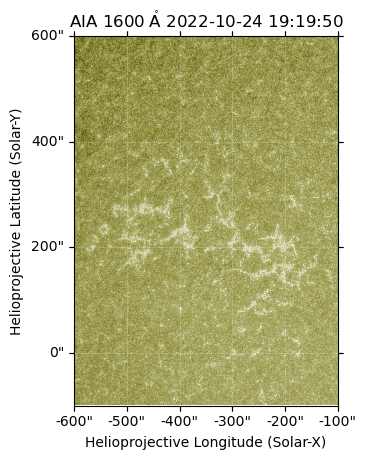

In [12]:
aia_1600_map_crop = aia_1600_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1600_map.coordinate_frame), 
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1600_map.coordinate_frame))
aia_1600_map_crop.plot()

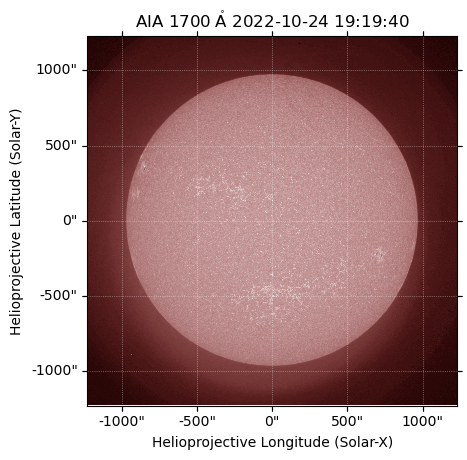

In [13]:
aia_1700_map = sunpy.map.Map("../../src/AIA/20221024/1700/lvl15/aia.lev1_uv_24s.2022-10-24T191951Z.1700.image.fits")
aia_1700_map.plot()

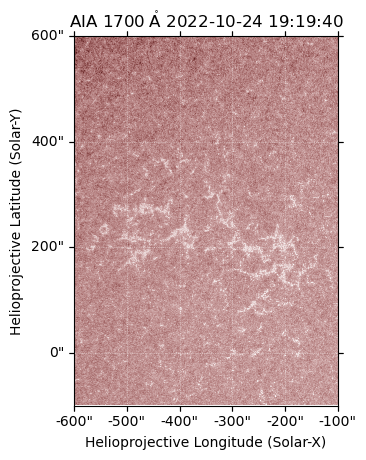

In [14]:
aia_1700_map_crop = aia_1700_map.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_1700_map.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_1700_map.coordinate_frame))
aia_1700_map_crop.plot()

In [15]:
SunBlinker(aia_193_map_crop,aia_171_map_crop)

In [16]:
iris_1400_sji_cube = irispy.io.read_files("../../src/IRIS/20221024/1949/iris_l2_20221024_194939_3600109162_SJI_1400_t000.fits",memmap=True)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


For frame 'heliographic_stonyhurst' the following metadata is missing: hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: crln_obs,crlt_obs
 [sunpy.map.mapbase]


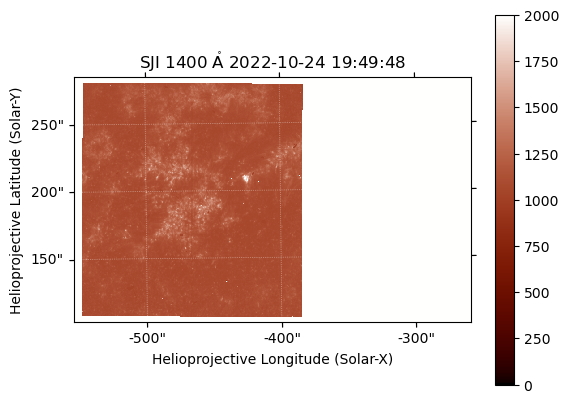

In [17]:
iris_1400_sji_cut = iris_1400_sji_cube[0]
iris_1400_sji_map = sunpy.map.Map(iris_1400_sji_cut.data+3.3e4,iris_1400_sji_cut.meta)
iris_1400_sji_map.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=2e3)
iris_1400_sji_map.plot()
plt.colorbar()

In [18]:
def coalign_shift(big_map, small_map):
    yshift, xshift = coalignment._calculate_shift(big_map.data, small_map.data)
    reference_coord = big_map.pixel_to_world(xshift, yshift)
    Txshift = reference_coord.Tx - small_map.bottom_left_coord.Tx
    Tyshift = reference_coord.Ty - small_map.bottom_left_coord.Ty

    return Txshift, Tyshift
    

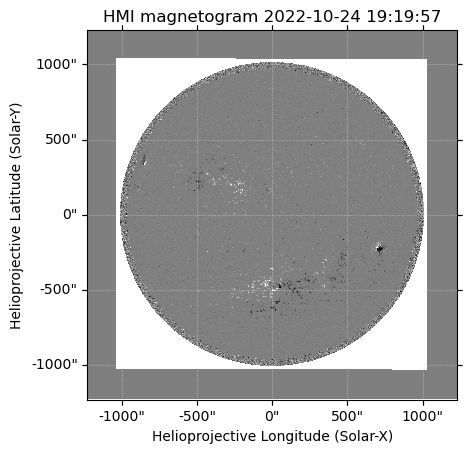

In [19]:
hmi_los_map = sunpy.map.Map("../../src/HMI/20221024/lvl15/hmi.M_45s.20221024_192100_TAI.2.magnetogram.fits")
hmi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
hmi_los_map.plot()

In [20]:
hmi_los_map_to_aia = hmi_los_map.reproject_to(aia_193_map.wcs)

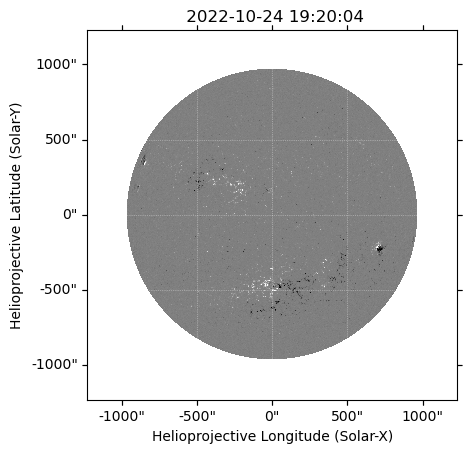

In [21]:
hmi_los_map_to_aia.plot()

In [22]:
hmi_los_map_to_aia_crop = hmi_los_map_to_aia.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=hmi_los_map_to_aia.coordinate_frame))

In [23]:
SunBlinker(aia_1600_map_crop,hmi_los_map_to_aia_crop)

For frame 'heliographic_stonyhurst' the following metadata is missing: dsun_obs,hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: dsun_obs,crln_obs,crlt_obs
 [sunpy.map.mapbase]


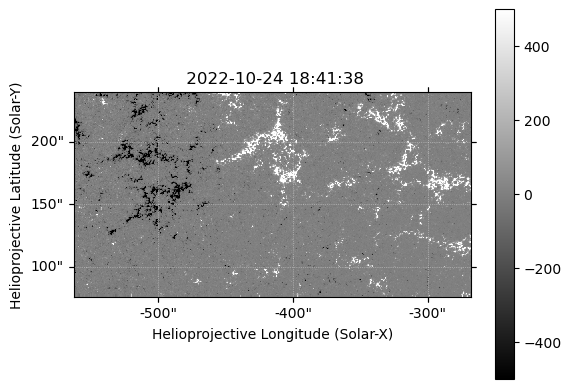

In [24]:
with fits.open("../../src/SOTSP/20221024/lvl21/20221024_184138_L2.1.fits") as hdul:
    sotsp_header = deepcopy(hdul[0].header)
    # for keys in hdul[1].header.keys():
    #     sotsp_header[keys] = hdul[1].header[keys]
    sotsp_header['CUNIT1'] = 'arcsec'
    sotsp_header['CUNIT2'] = 'arcsec'
    sotsp_header['CTYPE1'] = 'HPLN-TAN'
    sotsp_header['CTYPE2'] = 'HPLT-TAN'
    sotsp_header['CRVAL1'] = sotsp_header['XCEN']
    sotsp_header['CRVAL2'] = sotsp_header['YCEN']
    sotsp_header['CDELT1'] = sotsp_header['XSCALE']
    sotsp_header['CDELT2'] = sotsp_header['YSCALE'] 
    sotsp_header['NAXIS'] = 2
    sotsp_header['RSUN_REF'] = sotsp_header['SOLAR_RA']
    sotsp_header['DATE-OBS'] = sotsp_header['TSTART']
    sotsp_br = hdul[4].data[:]

sotsp_br_map = sunpy.map.Map(sotsp_br,sotsp_header)
sotsp_br_map.plot_settings['cmap'] = "gray"
sotsp_br_map.plot_settings['norm'] = plt.Normalize(-500, 500)
sotsp_br_map.plot()
plt.colorbar()

In [25]:
sotsp_resample_nx = (sotsp_br_map.scale.axis1 * sotsp_br_map.dimensions.x) / hmi_los_map_to_aia_crop.scale.axis1.to(u.arcsec/u.pix)
sotsp_resample_ny = (sotsp_br_map.scale.axis2 * sotsp_br_map.dimensions.y) / hmi_los_map_to_aia_crop.scale.axis2.to(u.arcsec/u.pix)
sotsp_br_map_resample = sotsp_br_map.resample(u.Quantity([sotsp_resample_nx, sotsp_resample_ny]))

In [26]:
Txshift_sotsp_hmi, Tyshift_sotsp_hmi = coalign_shift(hmi_los_map_to_aia_crop, sotsp_br_map_resample)
print(Txshift_sotsp_hmi, Tyshift_sotsp_hmi)

20.1888 arcsec 26.9726 arcsec


For frame 'heliographic_stonyhurst' the following metadata is missing: dsun_obs,hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: dsun_obs,crln_obs,crlt_obs
 [sunpy.map.mapbase]


In [27]:
sotsp_br_map_shift = sotsp_br_map.shift_reference_coord(Txshift_sotsp_hmi,Tyshift_sotsp_hmi)

In [28]:
with sunpy.coordinates.Helioprojective.assume_spherical_screen(sotsp_br_map_shift.observer_coordinate):
    hmi_los_map_to_aia_crop_repro_tosp = hmi_los_map_to_aia_crop.reproject_to(sotsp_br_map_shift.wcs)

For frame 'heliographic_stonyhurst' the following metadata is missing: dsun_obs,hglt_obs,hgln_obs
For frame 'heliographic_carrington' the following metadata is missing: dsun_obs,crln_obs,crlt_obs
 [sunpy.util.logger]


In [29]:
SunBlinker(sotsp_br_map_shift,hmi_los_map_to_aia_crop_repro_tosp)

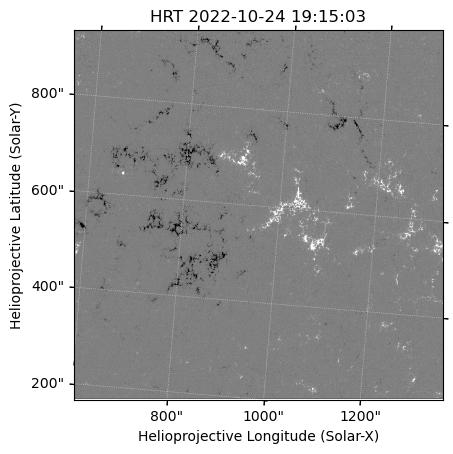

In [30]:
phi_los_map = sunpy.map.Map("../../src/PHI/20221024/solo_L2_phi-hrt-blos_20221024T191503_V01.fits")
phi_los_map.plot_settings['norm'] = plt.Normalize(-500, 500)
phi_los_map.plot()

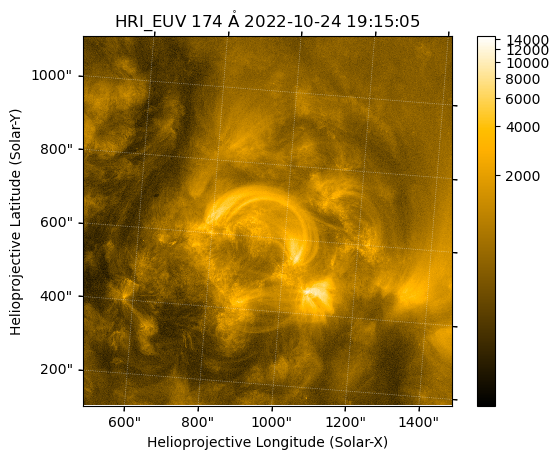

In [31]:
hri_174_map = sunpy.map.Map("../../src/EUI/HRI/euv174/20221024/solo_L2_eui-hrieuv174-image_20221024T191505172_V01.fits")
hri_174_map.plot()
plt.colorbar()

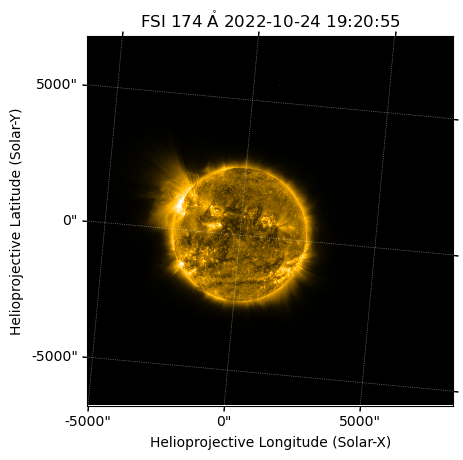

In [32]:
fsi_174_map = sunpy.map.Map("../../src/EUI/FSI/euv174/20221024/solo_L2_eui-fsi174-image_20221024T192050179_V01.fits")
fsi_174_map.plot()

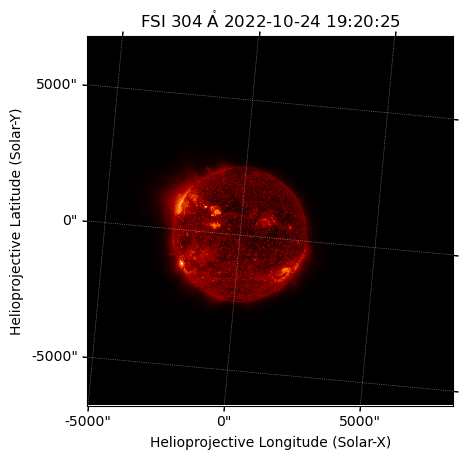

In [33]:
fsi_304_map = sunpy.map.Map("../../src/EUI/FSI/euv304/20221024/solo_L2_eui-fsi304-image_20221024T192020179_V01.fits")
fsi_304_map.plot()

Reading fit result from, 
   ../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5
INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


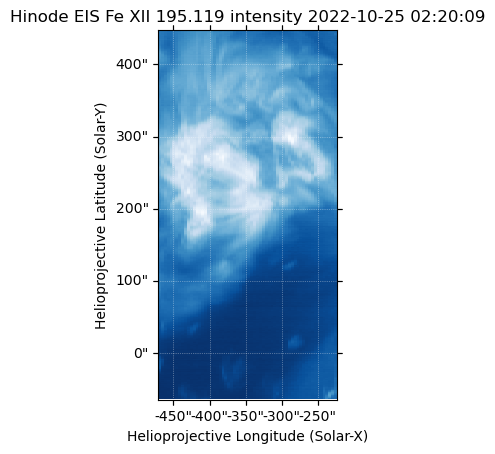

In [34]:
eis_195_fitres = eispac.read_fit("../../src/EIS/DHB_007_v2/20221025T0023/eis_20221025_014811.fe_12_195_119.1c-0.fit.h5")
eis_195_intmap = eis_195_fitres.get_map(component=0,measurement="intensity")
eis_195_intmap.plot()

In [35]:
aia_resample_nx = (aia_193_map_eis_crop.scale.axis1 * aia_193_map_eis_crop.dimensions.x) / eis_195_intmap.scale.axis1
aia_resample_ny = (aia_193_map_eis_crop.scale.axis2 * aia_193_map_eis_crop.dimensions.y) / eis_195_intmap.scale.axis2
aia_193_map_resample = aia_193_map_eis_crop.resample(u.Quantity([aia_resample_nx, aia_resample_ny]))

In [36]:
eis_to_aia_Txshift, eis_to_aia_Tyshift = coalign_shift(aia_193_map_resample,eis_195_intmap)
print(eis_to_aia_Txshift)
print(eis_to_aia_Tyshift)
eis_195_intmap_shift = eis_195_intmap.shift_reference_coord(eis_to_aia_Txshift,eis_to_aia_Tyshift)

3.90053 arcsec
-3.19133 arcsec


INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/core.py:257: UserWarning: The following kwargs were not used by contour: 'axesd'
  cset = super().contour(*args, **kwargs)


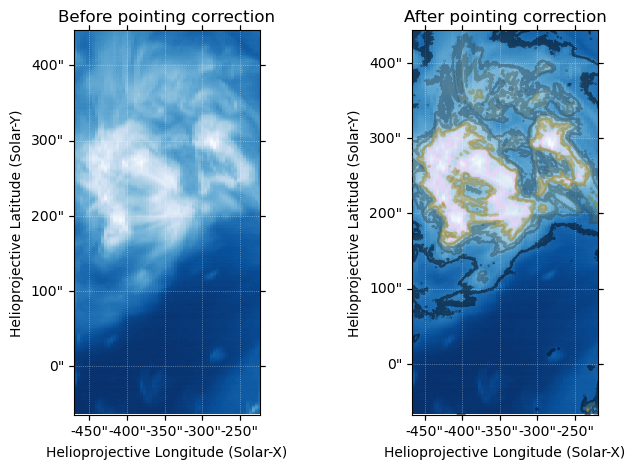

In [37]:
fig = plt.figure(figsize=(8,5))
ax1 = fig.add_subplot(121,projection=eis_195_intmap)
eis_195_intmap.plot(axes=ax1, title='Before pointing correction')

ax2 = fig.add_subplot(122,projection=eis_195_intmap_shift)
eis_195_intmap_shift.plot(axes=ax2, title='After pointing correction')

aia_levels = [200, 400, 500, 700, 800, 1200] * aia_193_map_eis.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis.draw_contours(aia_levels, axesd=ax_, cmap=cmcm.batlowK, alpha=0.3)
    ax_.axis(bounds)

In [38]:
with propagate_with_solar_surface():
    aia_193_map_eis_derot = aia_193_map_eis.reproject_to(aia_193_map.wcs)

In [39]:
aia_193_map_eis_compare = aia_193_map_eis_derot.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame),
                                        top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=aia_193_map_eis_derot.coordinate_frame))

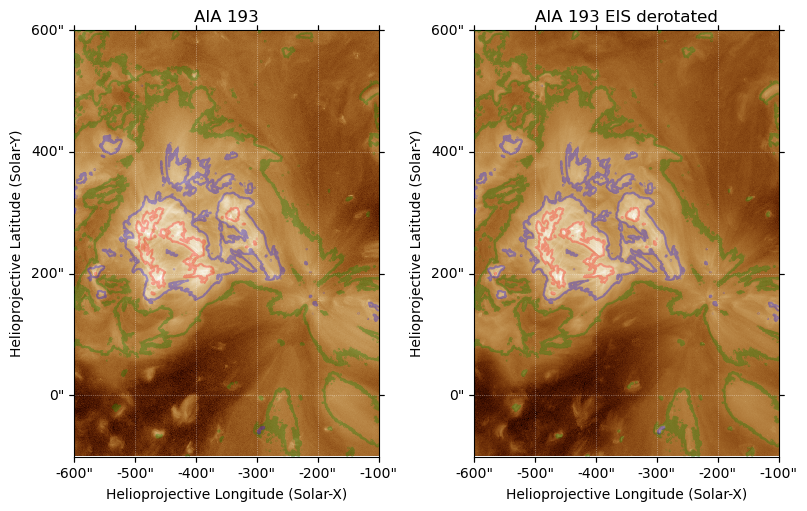

In [40]:
fig = plt.figure(figsize=(8,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
aia_193_map_crop.plot(axes=ax1, title='AIA 193')

ax2 = fig.add_subplot(122,projection=aia_193_map_eis_compare)
aia_193_map_eis_compare.plot(axes=ax2, title='AIA 193 EIS derotated')

aia_levels = [200, 500, 1200] 

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_eis_compare.draw_contours(aia_levels, axes=ax_, colors=["g","b","r"], alpha=0.3)
    ax_.axis(bounds)

In [41]:
SunBlinker(aia_193_map_crop,aia_193_map_eis_compare)

In [42]:
def derotate_fsi(fsi_map, hri_map,algorithm="adaptive"):
    out_frame = hri_map.coordinate_frame
    out_center = SkyCoord(0*u.arcsec, 0*u.arcsec, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(fsi_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(fsi_map.scale),
                                        rotation_matrix=hri_map.rotation_matrix) 
    # correct the tiny rotation matrix difference between FSI and HRI, which simply the coalignment
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        fsi_map_derot = fsi_map.reproject_to(out_wcs,algorithm=algorithm)

    return fsi_map_derot


In [43]:
fsi_174_map_hri_time = derotate_fsi(fsi_174_map,hri_174_map)

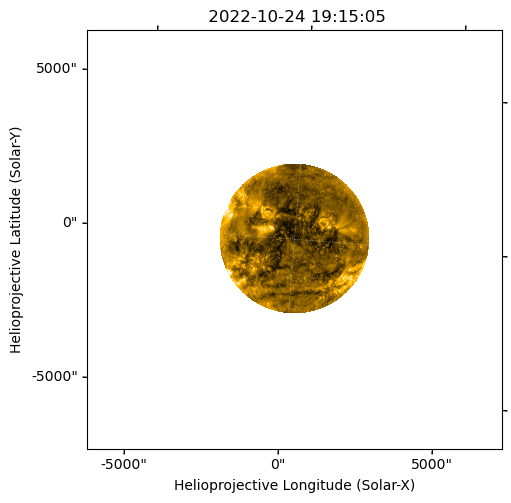

In [44]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)

ax1 = fig.add_subplot(111,projection=fsi_174_map_hri_time)
fsi_174_map_hri_time.plot()

In [45]:
fsi_174_crop = fsi_174_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_174_map_hri_time.coordinate_frame))

In [46]:
hri_174_map_repro = hri_174_map.reproject_to(fsi_174_crop.wcs)

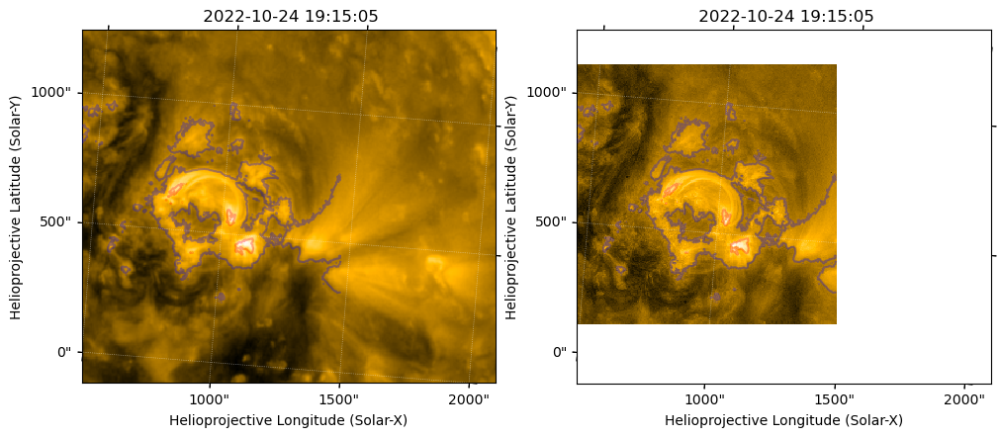

In [47]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()

ax2 = fig.add_subplot(122,projection=hri_174_map_repro)
im2 = hri_174_map_repro.plot()

hri_levels = [1000,5000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_repro.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


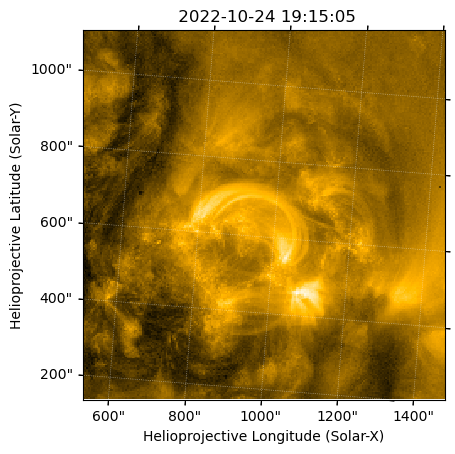

In [48]:
hri_174_map_repro_cut = hri_174_map_repro.submap([10,57]*u.pix,
                                                 top_right=[224,275]*u.pix)
hri_174_map_repro_cut.plot()

In [49]:
Txshift_hri, Tyshift_hri = coalign_shift(fsi_174_crop,hri_174_map_repro_cut)
print(Txshift_hri, Tyshift_hri)

1.67083 arcsec 7.60192 arcsec


In [50]:
hri_174_map_repro_shift = hri_174_map_repro.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_repro_cut_shift = hri_174_map_repro_cut.shift_reference_coord(Txshift_hri,Tyshift_hri)
hri_174_map_shifted = hri_174_map.shift_reference_coord(Txshift_hri,Tyshift_hri)
# hri_174_map_shifted = hri_174_map_shifted.submap([10,10]*u.pix,
#                                                     top_right=[2038,2038]*u.pix)
fsi_174_hri_fov = fsi_174_map_hri_time.reproject_to(hri_174_map_shifted.wcs)

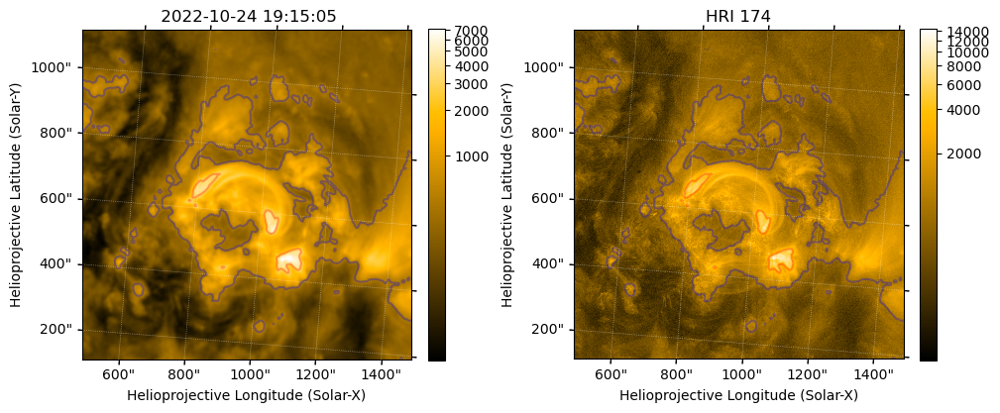

In [51]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_hri_fov)
im1 = fsi_174_hri_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = hri_174_map_shifted.plot()
ax2.set_title("HRI 174")
plt.colorbar(ax=ax2,shrink=0.75)

fsi_174_levels = [500,3000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_174_hri_fov.draw_contours(fsi_174_levels,colors=["b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [52]:
SunBlinker(fsi_174_hri_fov, hri_174_map_shifted,figsize=(6,6))

In [53]:
fsi_304_map_hri_time = derotate_fsi(fsi_304_map,hri_174_map)

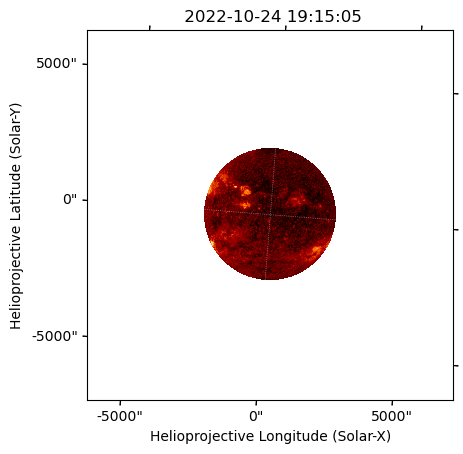

In [54]:
fsi_304_map_hri_time.plot()

In [55]:
fsi_304_crop = fsi_304_map_hri_time.submap(SkyCoord(500*u.arcsec,0*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame),
                                    top_right=SkyCoord(2000*u.arcsec,1250*u.arcsec,frame=fsi_304_map_hri_time.coordinate_frame))

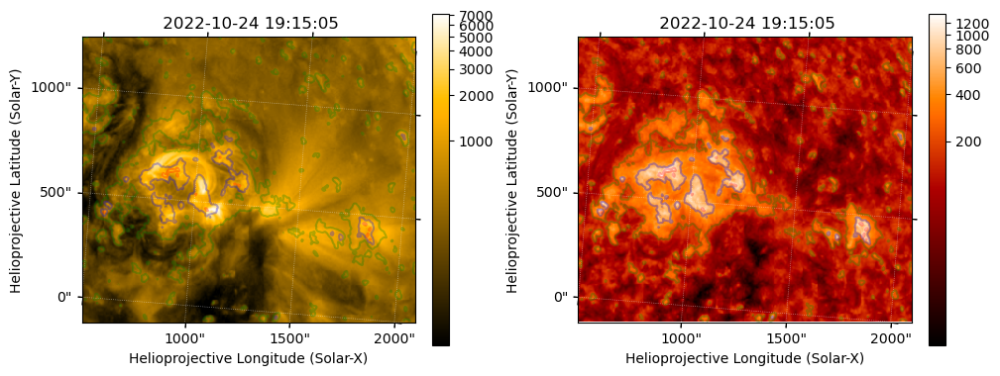

In [56]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=fsi_174_crop)
im1 = fsi_174_crop.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [57]:
SunBlinker(fsi_174_crop, fsi_304_crop)

In [58]:
aia_304_map_repro = aia_304_map.reproject_to(fsi_304_crop.wcs)

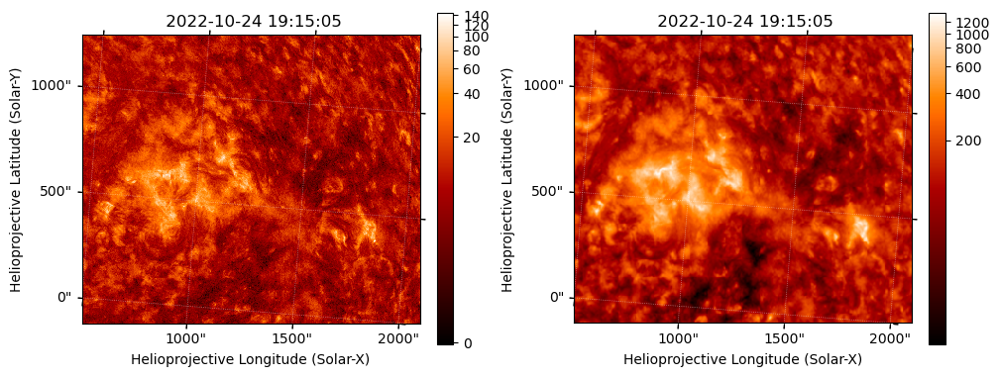

In [59]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop)
im2 = fsi_304_crop.plot()
plt.colorbar(ax=ax2,shrink=0.75)

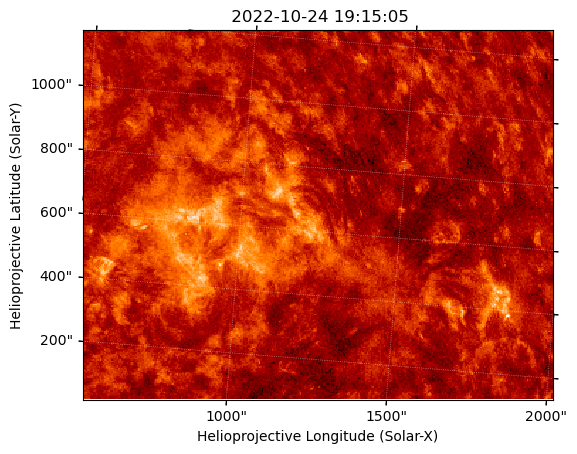

In [60]:
aia_304_map_repro_cut = aia_304_map_repro.submap([12,30]*u.pix,
                                                    top_right=[343,290]*u.pix)
aia_304_map_repro_cut.plot()

In [61]:
Txshift_aia_fsi, Tyshift_aia_fsi = coalign_shift(fsi_304_crop,aia_304_map_repro_cut)
print(Txshift_aia_fsi, Tyshift_aia_fsi)

-1.40322 arcsec 2.32321 arcsec


In [62]:
fsi_304_crop_shift = fsi_304_crop.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
fsi_174_crop_shift = fsi_174_crop.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
hri_174_map_shifted_toaia = hri_174_map_shifted.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)
fsi_304_map_hri_time_shift = fsi_304_map_hri_time.shift_reference_coord(-Txshift_aia_fsi,-Tyshift_aia_fsi)

In [63]:
hri_174_map_shifted_toaia.save("../../src/coalign_map/20221024/hri_174_map_shifted_toaia.fits",overwrite=True)
fsi_304_map_hri_time_shift.save("../../src/coalign_map/20221024/fsi_304_map_hri_time_shift.fits",overwrite=True)

In [64]:
coalign_shift(fsi_304_crop_shift,aia_304_map.reproject_to(fsi_304_crop_shift.wcs).submap([20,20]*u.pix,
                                                                                         top_right=[280,280]*u.pix))

(<Angle -0.79577775 arcsec>, <Angle 0.00830322 arcsec>)

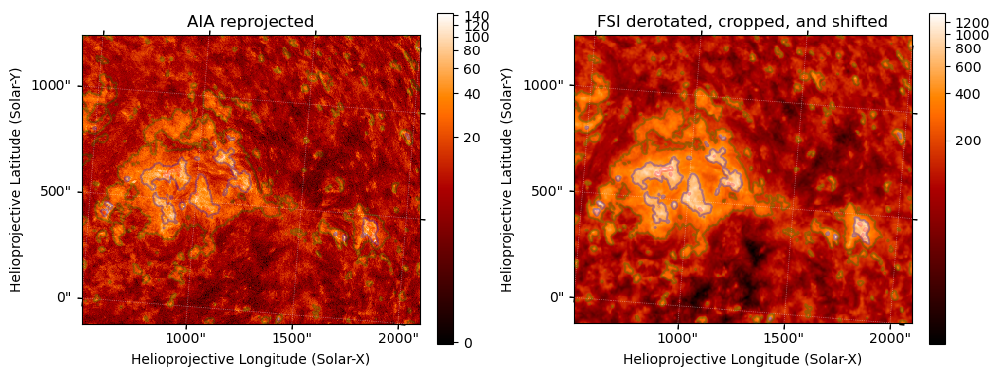

In [65]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_304_map_repro)
im1 = aia_304_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected")

ax2 = fig.add_subplot(122,projection=fsi_304_crop_shift)
im2 = fsi_304_crop_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated, cropped, and shifted")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop_shift.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [66]:
SunBlinker(aia_304_map_repro, fsi_304_map_hri_time_shift, reproject=True)

In [67]:
aia_1600_map_repro = aia_1600_map.reproject_to(fsi_304_crop_shift.wcs)

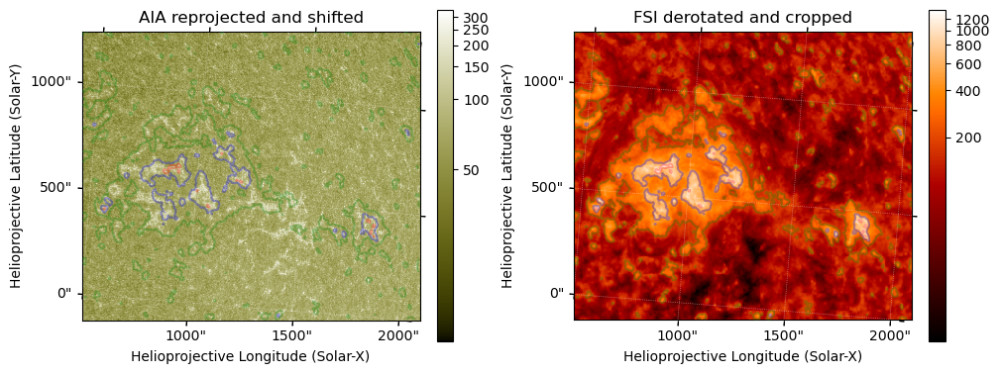

In [68]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_repro)
im1 = aia_1600_map_repro.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA reprojected and shifted")

ax2 = fig.add_subplot(122,projection=fsi_304_crop_shift)
im2 = fsi_304_crop_shift.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("FSI derotated and cropped")

fsi_304_levels = [200,500,1000]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    fsi_304_crop_shift.draw_contours(fsi_304_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)


In [69]:
SunBlinker(aia_1600_map_repro, fsi_304_crop_shift)

In [70]:
aia_171_repro = aia_171_map.reproject_to(fsi_304_crop_shift.wcs)

In [71]:
aia_171_repro_hrifov = aia_171_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

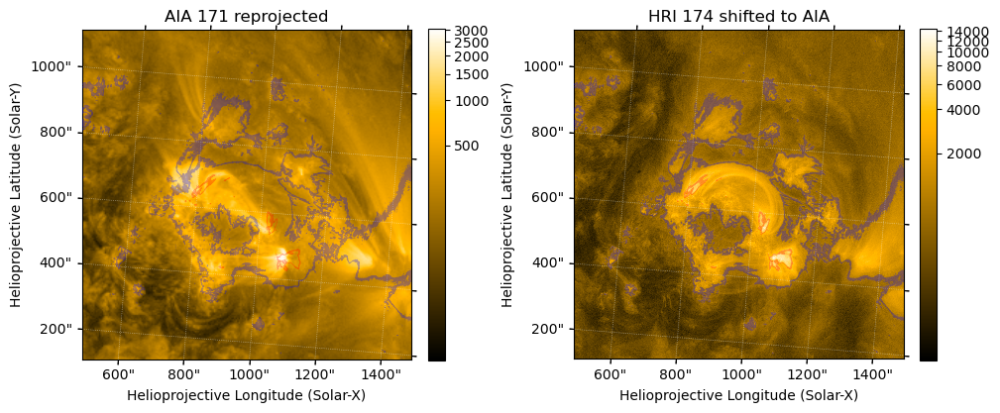

In [72]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_171_repro_hrifov)
im1 = aia_171_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 171 reprojected")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to AIA")

hri_levels = [1000,5000]*hri_174_map_shifted_toaia.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted_toaia.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [73]:
SunBlinker(aia_171_repro_hrifov, hri_174_map_shifted_toaia)

In [74]:
aia_193_repro = aia_193_map.reproject_to(fsi_304_crop_shift.wcs)
aia_193_repro_hrifov = aia_193_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

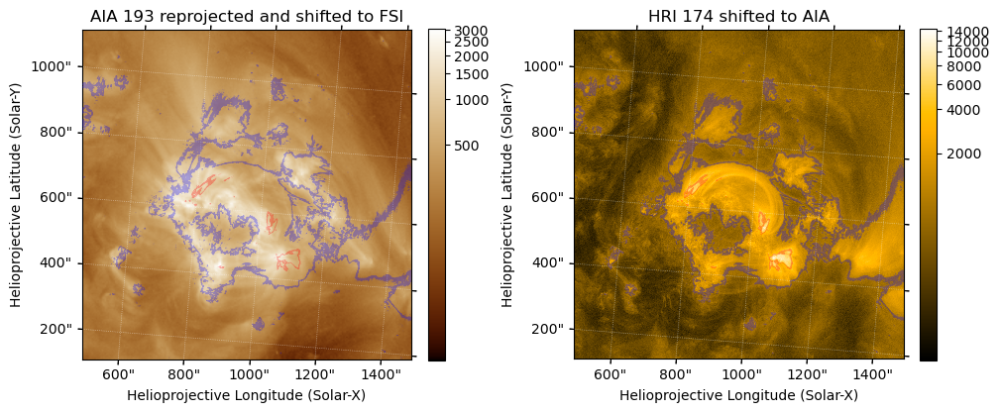

In [75]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_repro_hrifov)
im1 = aia_193_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("AIA 193 reprojected and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)
ax2.set_title("HRI 174 shifted to AIA")

hri_levels = [1000,5000]*hri_174_map_shifted_toaia.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hri_174_map_shifted_toaia.draw_contours(hri_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [76]:
SunBlinker(aia_193_repro_hrifov, hri_174_map_shifted_toaia)

In [77]:
hmi_los_map_repro = hmi_los_map_to_aia.reproject_to(fsi_304_crop_shift.wcs)
hmi_los_map_repro_hrifov = hmi_los_map_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

In [78]:
fsi_304_crop_hrifov_toaia = fsi_304_crop_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

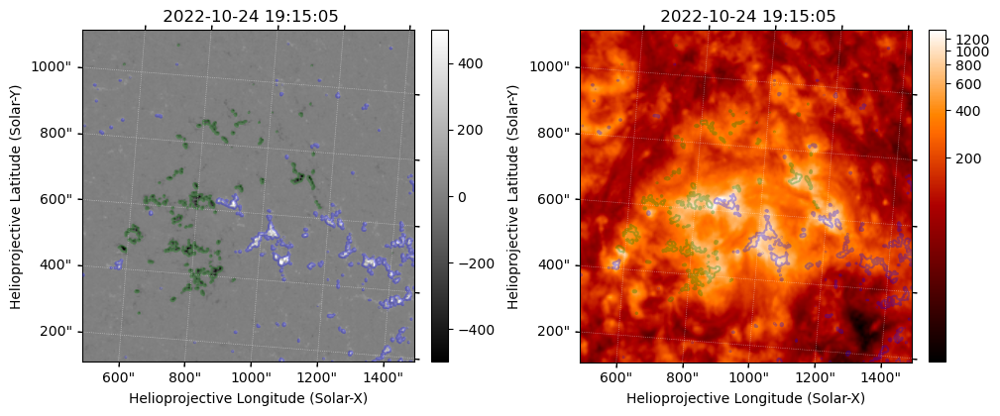

In [79]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_hrifov)
im1 = hmi_los_map_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=fsi_304_crop_hrifov_toaia)
im2 = fsi_304_crop_hrifov_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)
    

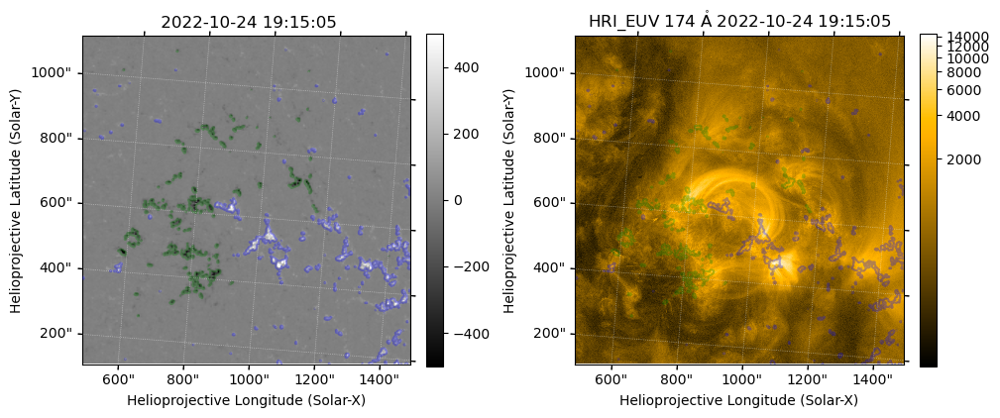

In [80]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hmi_los_map_repro_hrifov)
im1 = hmi_los_map_repro_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels = [-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro_hrifov.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

In [81]:
SunBlinker(hmi_los_map_repro_hrifov, hri_174_map_shifted_toaia)

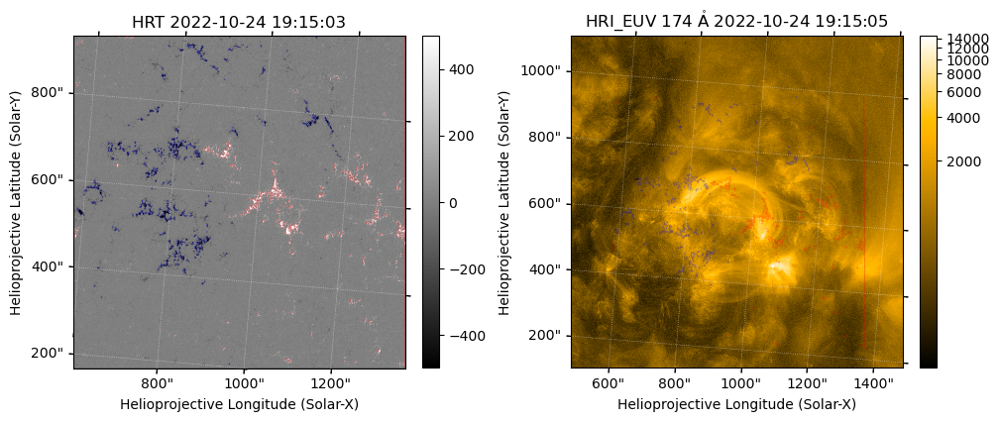

In [82]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map)
im1 = phi_los_map.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map)
im2 = hri_174_map.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

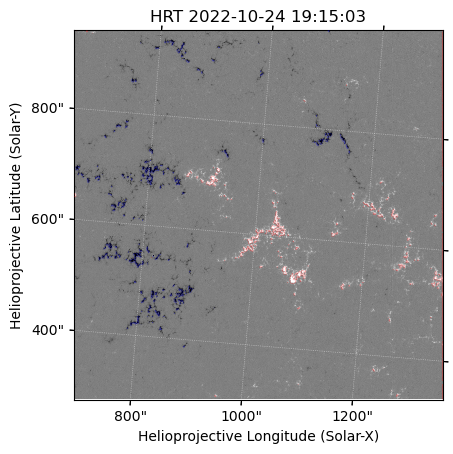

In [83]:
phi_los_map_crop = phi_los_map.submap([200,200]*u.pix,
                                      top_right=[1847,1847]*u.pix)

phi_los_map_crop.plot()
phi_los_map_crop.draw_contours([-300,300]*phi_los_map_crop.unit,colors=["b","r"], alpha=0.3,linewidths=0.5)

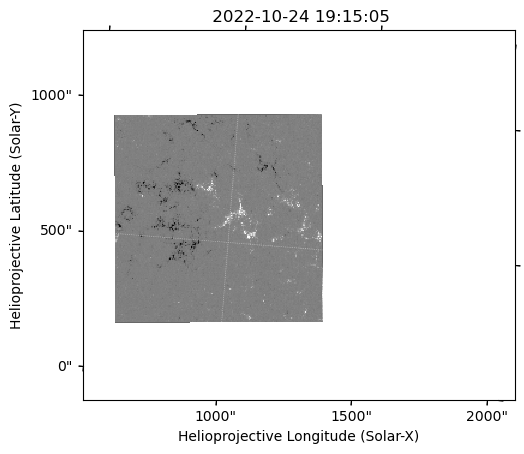

In [84]:
phi_los_map_resample = phi_los_map.reproject_to(fsi_304_crop_shift.wcs)
phi_los_map_resample.plot()

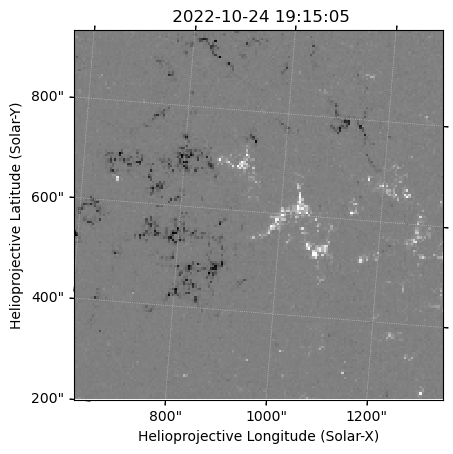

In [85]:
phi_los_map_resample_crop = phi_los_map_resample.submap([30,70]*u.pix,
                                                        top_right=[195,235]*u.pix)
phi_los_map_resample_crop.plot()

In [86]:
Txshift_phi_hmi, Tyshift_phi_hmi = coalign_shift(hmi_los_map_repro,phi_los_map_resample_crop)
print(Txshift_phi_hmi, Tyshift_phi_hmi)

-8.01496 arcsec -67.7583 arcsec


In [87]:
phi_los_map_shifted = phi_los_map.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)
phi_los_map_shifted_hrifov = phi_los_map_shifted.reproject_to(hri_174_map_shifted_toaia.wcs)
phi_los_map_resample_crop_shifted = phi_los_map_resample_crop.shift_reference_coord(Txshift_phi_hmi,Tyshift_phi_hmi)

In [88]:
phi_los_map_shifted.save("../../src/coalign_map/20221024/phi_los_map_shifted.fits",overwrite=True)

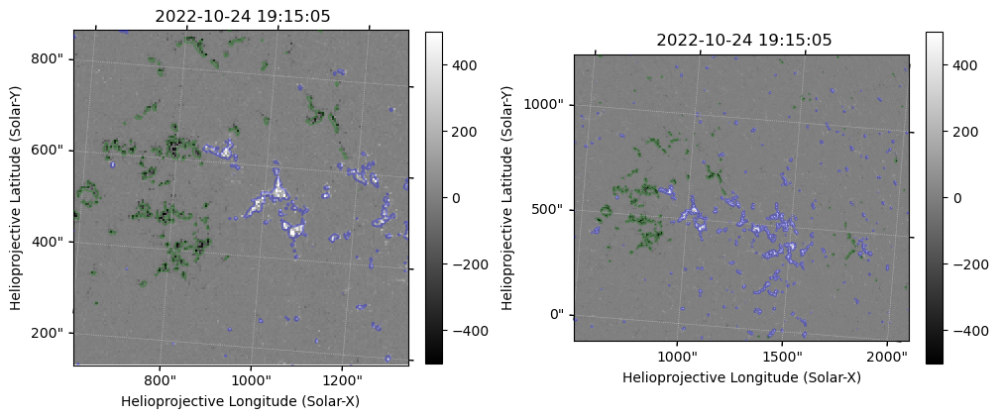

In [89]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_resample_crop_shifted)
im1 = phi_los_map_resample_crop_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro)
im2 = hmi_los_map_repro.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_hmi_coalign_1024.png",dpi=300,bbox_inches="tight")

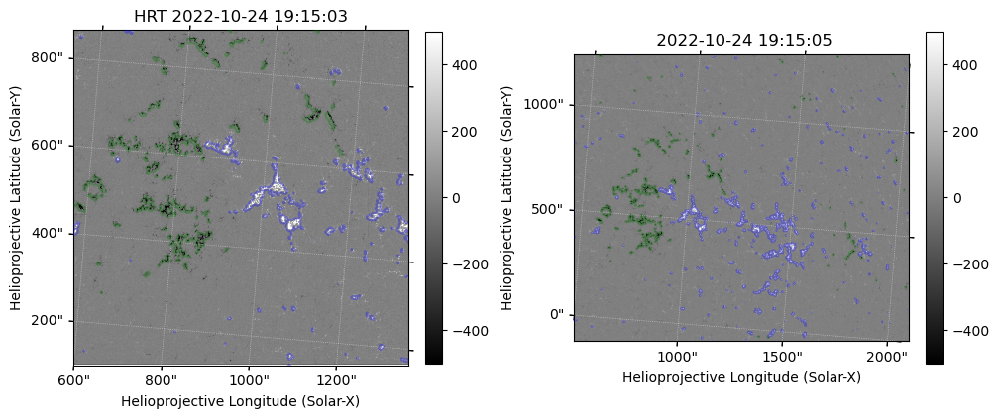

In [90]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted)
im1 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hmi_los_map_repro)
im2 = hmi_los_map_repro.plot()
plt.colorbar(ax=ax2,shrink=0.75)

hmi_los_levels=[-100,100]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    hmi_los_map_repro.draw_contours(hmi_los_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/phi_hmi_coalign_1024_highres.png",dpi=300,bbox_inches="tight")

In [91]:
sotsp_br_map_shift_phi_fov = sotsp_br_map_shift.reproject_to(phi_los_map_shifted.wcs)

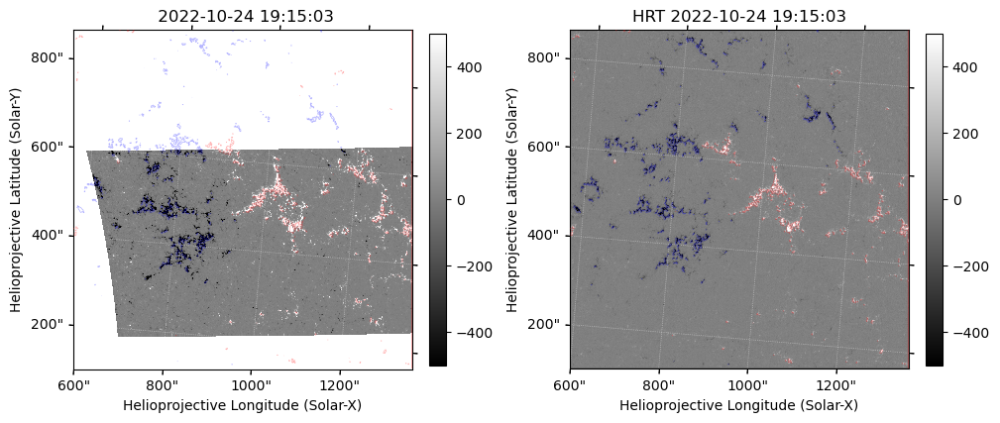

In [92]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=sotsp_br_map_shift_phi_fov)
im1 = sotsp_br_map_shift_phi_fov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=phi_los_map_shifted)
im2 = phi_los_map_shifted.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]*phi_los_map_shifted.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

plt.savefig("../../figs/test_figs/sotsp_phi_coalign_1024.png",dpi=300,bbox_inches="tight")

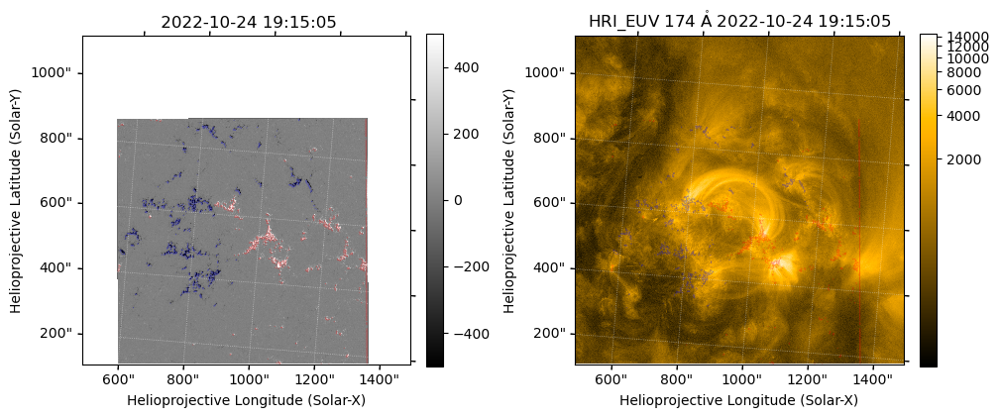

In [93]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=phi_los_map_shifted_hrifov)
im1 = phi_los_map_shifted_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

phi_levels = [-200,200]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    phi_los_map_shifted_hrifov.draw_contours(phi_levels,colors=["b","r"], axes=ax_, alpha=0.3,linewidths=0.5)
    ax_.axis(bounds)

In [94]:
SunBlinker(phi_los_map_shifted_hrifov.submap([217,10]*u.pix,top_right=[1700,1500]*u.pix), 
           hmi_los_map_repro_hrifov.submap([217,10]*u.pix,top_right=[1700,1500]*u.pix),
           figsize=(6,6))

In [95]:
eis_195_velmap = eis_195_fitres.get_map(component=0,measurement="vel")
eis_195_velmap.plot_settings['norm'] = ImageNormalize(vmin=-15,vmax=15)
eis_195_velmap_shift = eis_195_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_intmap_derot = eis_195_intmap_shift.reproject_to(aia_193_map_crop.wcs)
    eis_195_velmap_derot = eis_195_velmap_shift.reproject_to(aia_193_map_crop.wcs)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


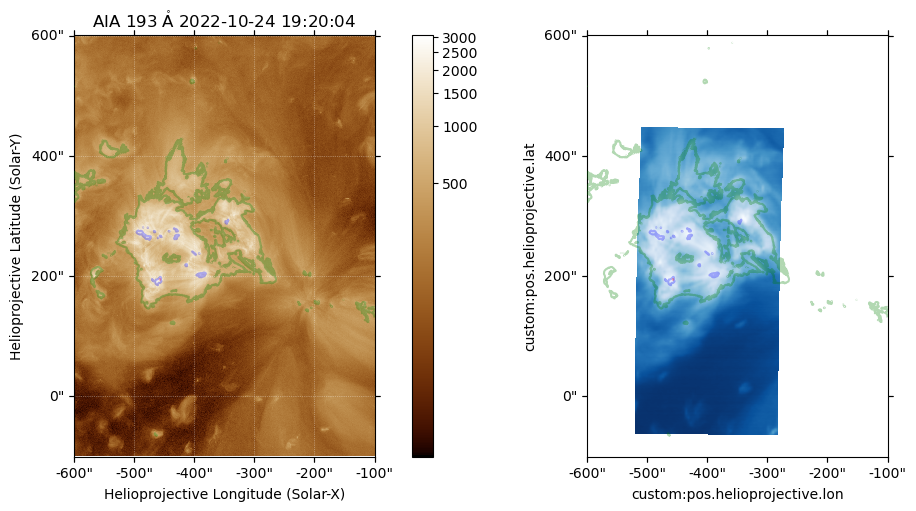

In [96]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
ax2.imshow(eis_195_intmap_derot.data,origin="lower",cmap=eis_195_intmap_derot.plot_settings['cmap'],norm=eis_195_intmap_derot.plot_settings['norm'])

aia_193_levels = [500,2000,3000]*aia_193_map_crop.unit

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_193_map_crop.draw_contours(aia_193_levels,colors=["g","b","r"], axes=ax_, alpha=0.3)
    ax_.axis(bounds)



In [97]:
SunBlinker(aia_193_map_crop, eis_195_intmap_derot)

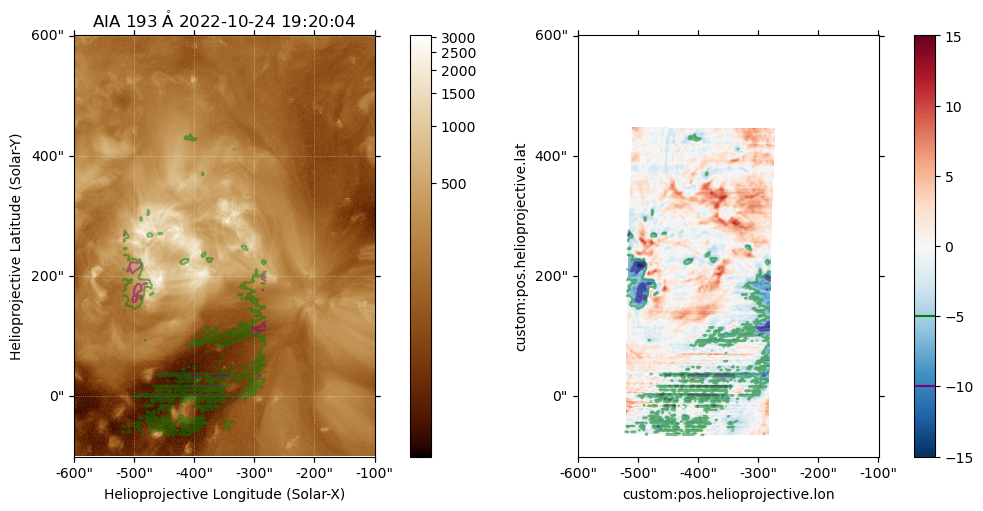

In [98]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_193_map_crop)
im1 = aia_193_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_193_map_crop)
im2 = ax2.imshow(eis_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
clb2 = plt.colorbar(im2,ax=ax2)
clb2.ax.axhline(-5,color="green")
clb2.ax.axhline(-10,color="purple")

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [99]:
SunBlinker(aia_193_map_crop, eis_195_velmap_derot)

In [100]:
eis_195_velmap_derot.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_velmap_derot.fits",overwrite=True)

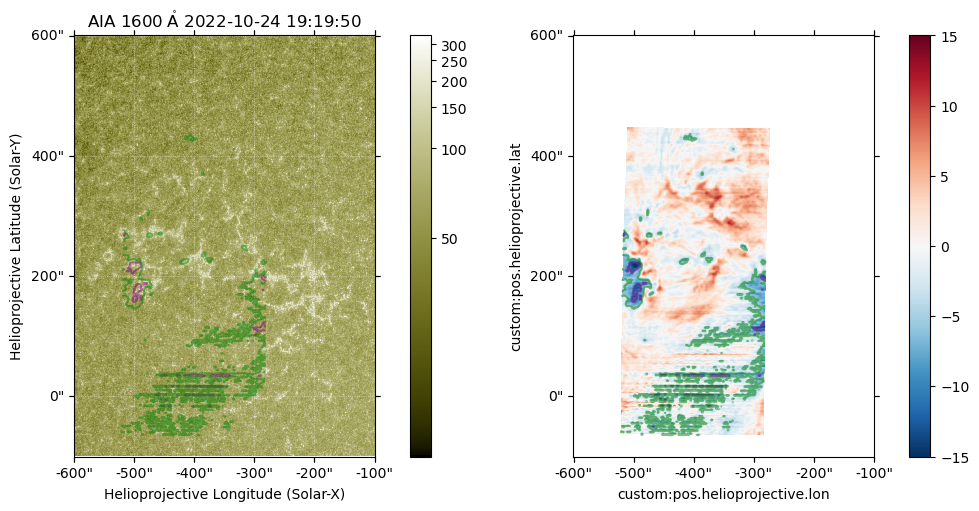

In [101]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=aia_1600_map_crop)
im1 = aia_1600_map_crop.plot()
plt.colorbar(ax=ax1)

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = ax2.imshow(eis_195_velmap_derot.data,origin="lower",cmap=eis_195_velmap_derot.plot_settings['cmap'],norm=eis_195_velmap_derot.plot_settings['norm'])
plt.colorbar(im2,ax=ax2)

eis_vel_levels = [-10,-5]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_velmap_derot.draw_contours(eis_vel_levels,colors=["purple","green"], axes=ax_, alpha=0.5)
    ax_.axis(bounds)

In [102]:
eis_195_intmap_derot_repro = eis_195_intmap_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_195_velmap_derot_repro = eis_195_velmap_derot.reproject_to(fsi_304_crop_shift.wcs)

In [103]:
eis_195_intmap_derot_repro_hrifov = eis_195_intmap_derot_repro.reproject_to(hri_174_map_shifted_toaia.wcs)
eis_195_velmap_derot_repro_hrifov = eis_195_velmap_derot_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

In [104]:
SunBlinker(hri_174_map_shifted, eis_195_intmap_derot_repro_hrifov)

In [105]:
SunBlinker(hri_174_map_shifted_toaia, eis_195_velmap_derot_repro_hrifov)

In [106]:
SunBlinker(aia_171_map_crop.submap([100,100]*u.pix,top_right=[550,900]*u.pix),
           eis_195_velmap_derot.submap([100,100]*u.pix,top_right=[550,900]*u.pix),)

/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


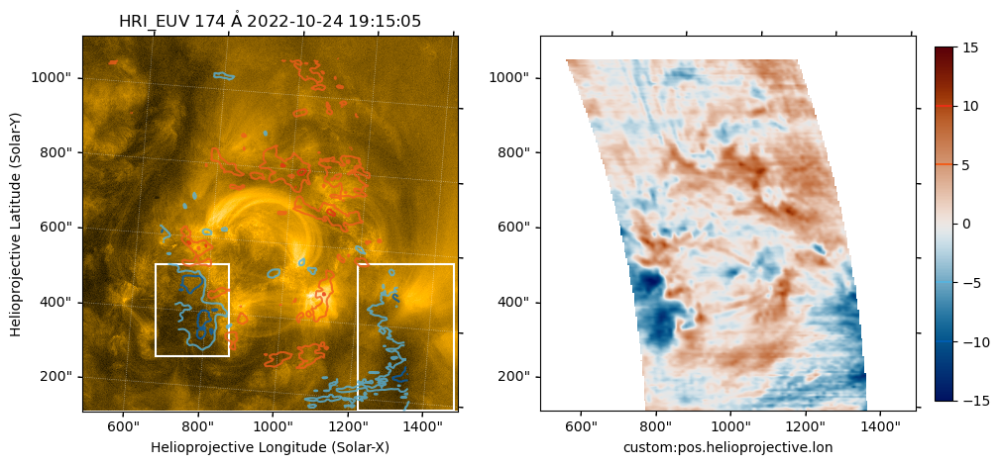

In [107]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()

eis_195_velmap_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_195_velmap_derot_repro_hrifov.data,vmin=-15,vmax=15,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [108]:
eis_195_velmap_derot_repro_hrifov.save("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_195_velmap_derot_repro_hrifov.fits",overwrite=True)

In [109]:
eis_195_width_map = eis_195_fitres.get_map(component=0,measurement="width")
eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
eis_195_v1oe = eis_195_true_width*u.angstrom/np.sqrt(4*np.log(2))*const.c/(195.119*u.angstrom)
vth2 = 2*const.k_B*(10**6.2)*u.K/const.u/55.85
vnth = np.sqrt(eis_195_v1oe**2 - vth2).to(u.km/u.s)

INFO: uncertainty should have attribute uncertainty_type. [astropy.nddata.nddata]


/tmp/ipykernel_2995600/4214942759.py:2: RuntimeWarning: invalid value encountered in sqrt
  eis_195_true_width = np.sqrt( (eis_195_width_map.data * np.sqrt(8*np.log(2)))**2 - (eis_195_fitres.meta["slit_width"][:,np.newaxis])**2)
/home/yjzhu/.local/lib/python3.11/site-packages/astropy/units/quantity.py:666: RuntimeWarning: invalid value encountered in sqrt
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


In [110]:
eis_195_vnth_map = sunpy.map.Map(vnth, eis_195_width_map.wcs)
eis_195_vnth_map_shift = eis_195_vnth_map.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)

with propagate_with_solar_surface(rotation_model="rigid"):
    eis_195_vnth_map_shift_derot = eis_195_vnth_map_shift.reproject_to(aia_193_map_crop.wcs)

eis_195_vnth_map_shift_derot_repro = eis_195_vnth_map_shift_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_195_vnth_map_shift_derot_repro_hrifov = eis_195_vnth_map_shift_derot_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


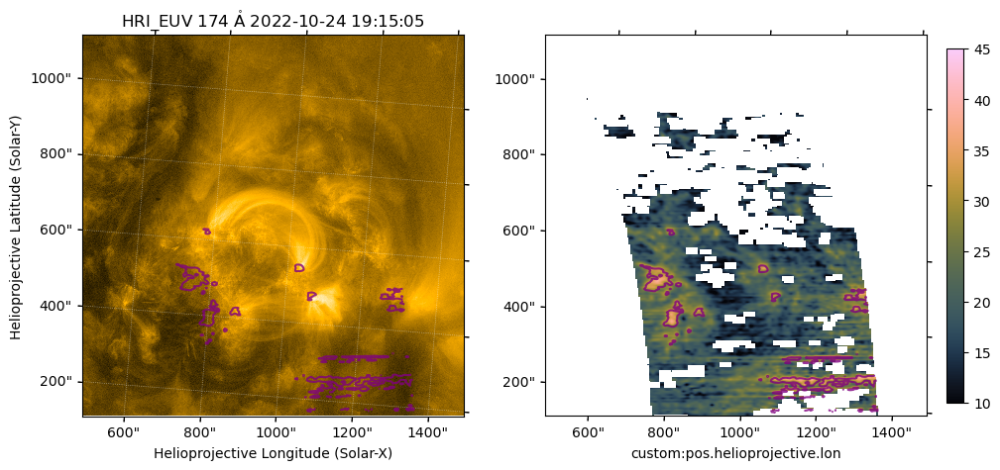

In [111]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()
# ax1.contour(eis_195_velmap_derot_repro_shifted_hrifov.data,levels=[-10,-5,5,10]*u.km/u.s,colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted)
im2 = ax2.imshow(eis_195_vnth_map_shift_derot_repro_hrifov.data,vmin=10,vmax=45,cmap=cmcm.batlowK,origin="lower")
plt.colorbar(im2,ax=ax2,shrink=0.8)

eis_195_vnth_levels = [30]
for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_vnth_map_shift_derot_repro_hrifov.draw_contours(eis_195_vnth_levels,colors=["purple"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

ax2.set_ylabel(" ")

In [112]:
SunBlinker(phi_los_map_shifted_hrifov, eis_195_velmap_derot_repro_hrifov)

In [113]:
def derotate_iris(iris_map, aia_map,algorithm="adaptive"):
    out_frame = aia_map.coordinate_frame
    out_center = SkyCoord(iris_map.center.Tx, iris_map.center.Ty, frame=out_frame)
    header = sunpy.map.make_fitswcs_header(iris_map.data.shape,
                                        out_center,
                                        scale=u.Quantity(iris_map.scale),
                                        rotation_matrix=aia_map.rotation_matrix) 
    # correct the tiny rotation matrix difference between FSI and HRI, which simply the coalignment
    out_wcs = WCS(header)

    with propagate_with_solar_surface():
        iris_map_derot = iris_map.reproject_to(out_wcs,algorithm=algorithm)

    return iris_map_derot


In [114]:
iris_1400_sji_map_rotate = derotate_iris(iris_1400_sji_map, aia_1700_map_crop)

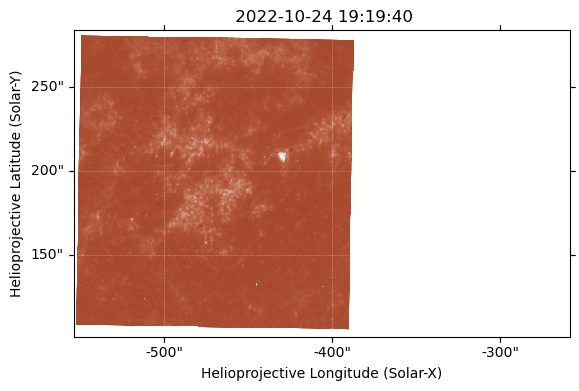

In [115]:
iris_1400_sji_map_rotate.plot()

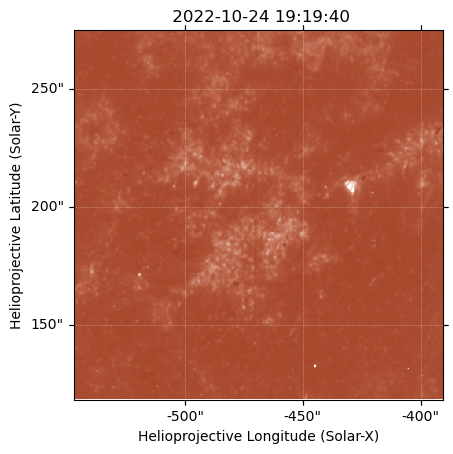

In [116]:
iris_1400_sji_map_rotate_crop = iris_1400_sji_map_rotate.submap([20,50]*u.pix,top_right=[490,520]*u.pix)
iris_1400_sji_map_rotate_crop.plot()

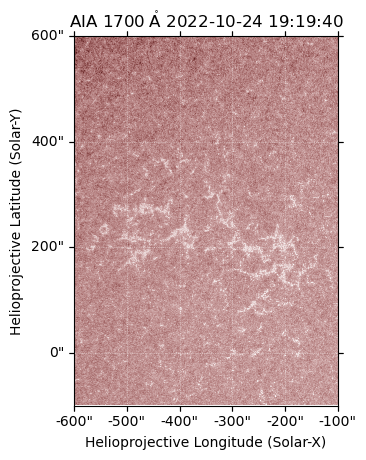

In [117]:
aia_1700_map_crop.plot()

In [118]:
iris_1400_resample_nx = (iris_1400_sji_map_rotate_crop.scale.axis1 * iris_1400_sji_map_rotate_crop.dimensions.x).to(u.arcsec) / aia_1700_map_crop.scale.axis1
iris_1400_resample_ny = (iris_1400_sji_map_rotate_crop.scale.axis2 * iris_1400_sji_map_rotate_crop.dimensions.y).to(u.arcsec) / aia_1700_map_crop.scale.axis2
iris_1400_sji_map_rotate_crop_resample = iris_1400_sji_map_rotate_crop.resample(u.Quantity([iris_1400_resample_nx, iris_1400_resample_ny]))

In [119]:
Txshift_iris_aia, Tyshift_iris_aia = coalign_shift(aia_1700_map_crop,iris_1400_sji_map_rotate_crop_resample)
print(Txshift_iris_aia, Tyshift_iris_aia)

-6.15406 arcsec 0.018131 arcsec


In [120]:
iris_1400_sji_map_rotate_crop_shift = iris_1400_sji_map_rotate_crop.shift_reference_coord(Txshift_iris_aia,Tyshift_iris_aia)
aia_1700_map_crop_iris_1400_fov = aia_1700_map_crop.reproject_to(iris_1400_sji_map_rotate_crop_shift.wcs)

In [121]:
SunBlinker(aia_1700_map_crop_iris_1400_fov, iris_1400_sji_map_rotate_crop_shift)

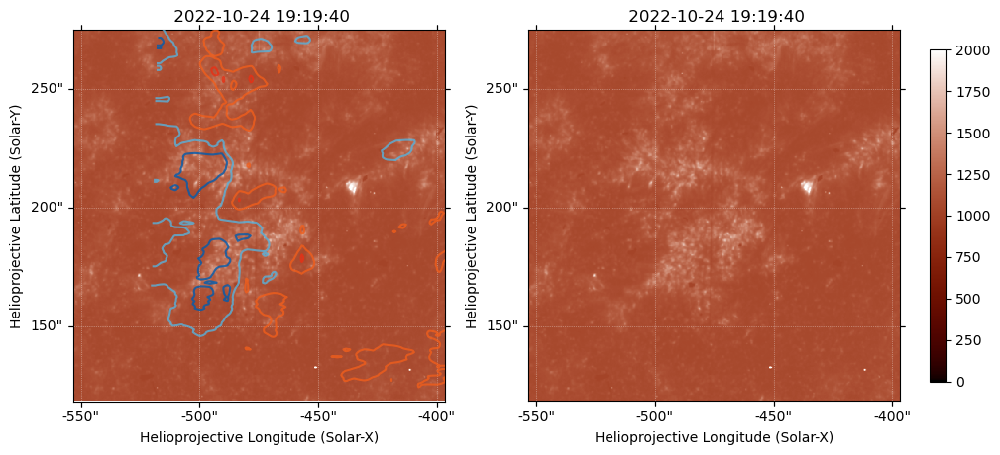

In [122]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=iris_1400_sji_map_rotate_crop_shift)
iris_1400_sji_map_rotate_crop_shift.plot(axes=ax1)


bounds = ax1.axis()
eis_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)
ax1.axis(bounds)

ax2 = fig.add_subplot(122,projection=iris_1400_sji_map_rotate_crop_shift)
iris_1400_sji_map_rotate_crop_shift.plot(axes=ax2)
plt.colorbar(ax=ax2,shrink=0.75)

In [123]:
iris_1400_sji_map_rotate_crop_shift.save("../../src/coalign_map/20221024/iris_1400_sji_map_rotate_crop_shift.fits",overwrite=True)

 [astropy.io.fits.verify]


In [124]:
spice_NeVIII_intmap = sunpy.map.Map("../../src/SPICE/20221024/lvl3/NeVIII_int_deconv_plowman2023.fits")
spice_NeVIII_intmap.plot_settings['cmap'] = "sdoaia171"
spice_NeVIII_intmap.plot_settings['norm'] = ImageNormalize(vmin=0,vmax=10,stretch=AsinhStretch(0.1))

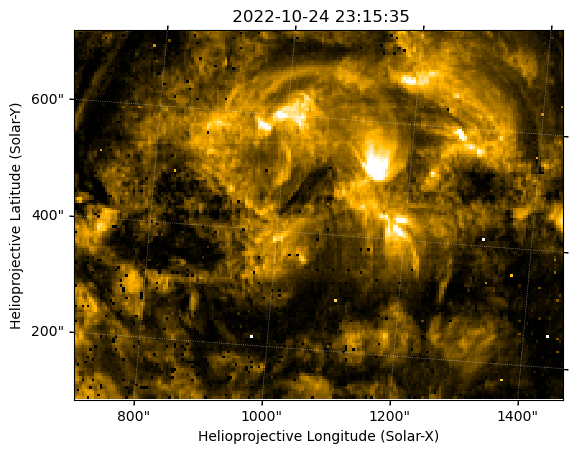

In [125]:
spice_NeVIII_intmap.plot()

In [126]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_intmap_derot = spice_NeVIII_intmap.reproject_to(fsi_174_crop_shift.wcs)

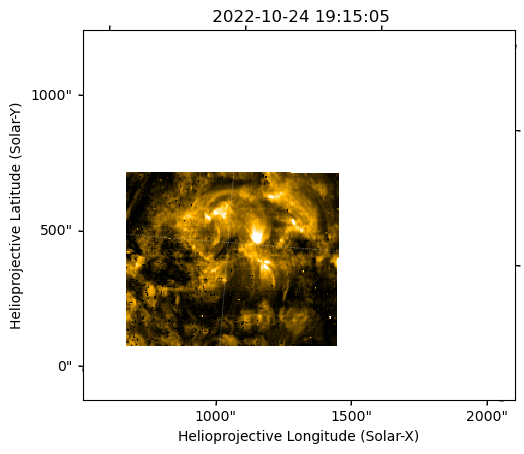

In [127]:
spice_NeVIII_intmap_derot.plot(aspect=fsi_174_crop_shift.scale.axis2/fsi_174_crop_shift.scale.axis1)

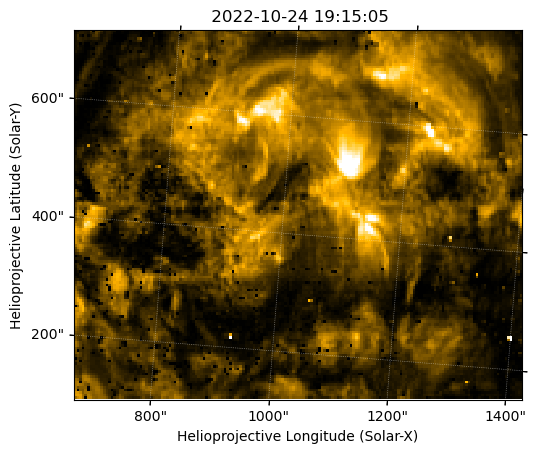

In [128]:
spice_NeVIII_intmap_derot_crop = spice_NeVIII_intmap_derot.submap([40,45]*u.pix,
                                                                  top_right=[210,185]*u.pix)
spice_NeVIII_intmap_derot_crop.plot(aspect=spice_NeVIII_intmap_derot_crop.scale.axis2/spice_NeVIII_intmap_derot_crop.scale.axis1)

In [129]:
spice_NeVIII_Txshift, spice_NeVIII_Tyshift = coalign_shift(fsi_174_crop_shift,spice_NeVIII_intmap_derot_crop)
print(spice_NeVIII_Txshift, spice_NeVIII_Tyshift)

-65.837 arcsec 34.0156 arcsec


In [130]:
spice_NeVIII_intmap_derot_shift = spice_NeVIII_intmap_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_intmap_derot_shift_hrifov = spice_NeVIII_intmap_derot_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

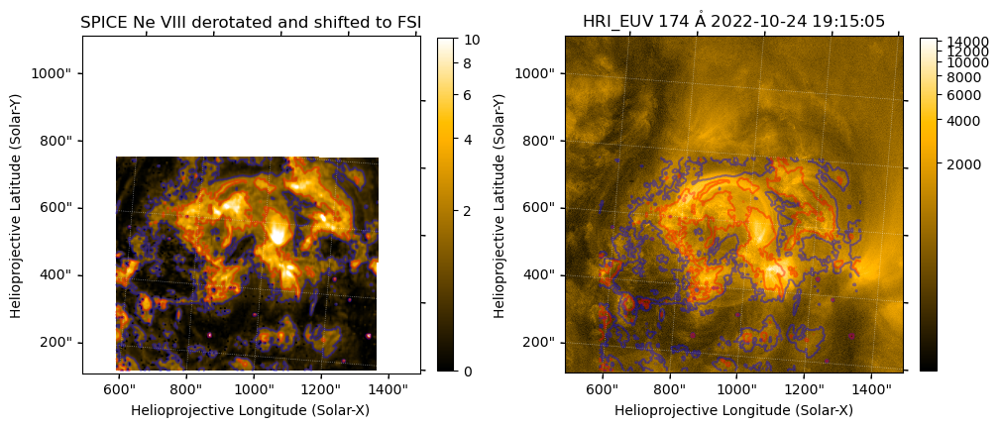

In [131]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_intmap_derot_shift_hrifov)
im1 = spice_NeVIII_intmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_levels = [0.8,2]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_intmap_derot_shift_hrifov.draw_contours(spice_NeVIII_levels,colors=["b","r"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [132]:
spice_NeVIII_velmap = sunpy.map.Map("../../src/SPICE/20221024/lvl3/NeVIII_vel_deconv_plowman2023.fits")
spice_NeVIII_velmap.plot_settings['cmap'] = "RdBu_r"
spice_NeVIII_velmap.plot_settings['norm'] = ImageNormalize(vmin=-40,vmax=40)

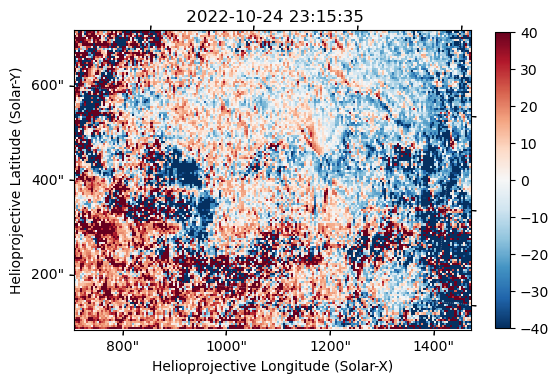

In [133]:
spice_NeVIII_velmap.plot()
plt.colorbar(shrink=0.8)

In [134]:
with propagate_with_solar_surface(rotation_model="rigid"):
    spice_NeVIII_velmap_derot = spice_NeVIII_velmap.reproject_to(fsi_174_crop_shift.wcs)

spice_NeVIII_velmap_derot_shift = spice_NeVIII_velmap_derot.shift_reference_coord(spice_NeVIII_Txshift,spice_NeVIII_Tyshift)
spice_NeVIII_velmap_derot_shift_hrifov = spice_NeVIII_velmap_derot_shift.reproject_to(hri_174_map_shifted_toaia.wcs)

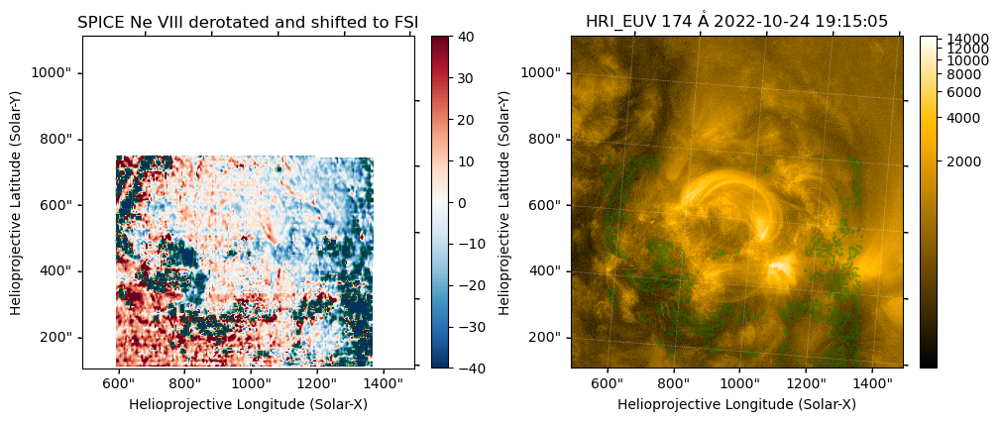

In [135]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_velmap_derot_shift_hrifov)
im1 = spice_NeVIII_velmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = hri_174_map_shifted_toaia.plot()
plt.colorbar(ax=ax2,shrink=0.75)

spice_NeVIII_vel_levels = [-40]

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_velmap_derot_shift_hrifov.draw_contours(spice_NeVIII_vel_levels,colors=["green"], axes=ax_, alpha=0.4)
    ax_.axis(bounds)

In [136]:
SunBlinker(spice_NeVIII_velmap_derot_shift_hrifov, hri_174_map_shifted_toaia)

In [137]:
SunBlinker(spice_NeVIII_velmap_derot_shift_hrifov, eis_195_velmap_derot_repro_hrifov)

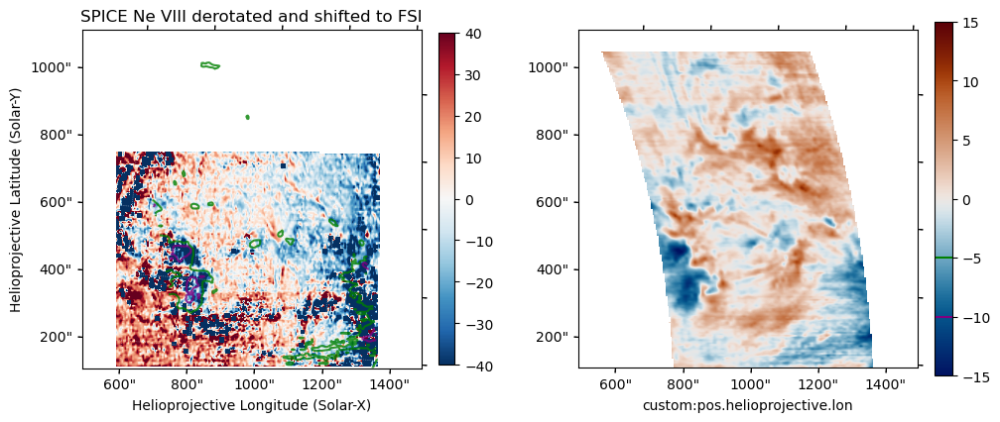

In [138]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=spice_NeVIII_velmap_derot_shift_hrifov)
im1 = spice_NeVIII_velmap_derot_shift_hrifov.plot()
plt.colorbar(ax=ax1,shrink=0.75)
ax1.set_title("SPICE Ne VIII derotated and shifted to FSI")

eis_195_velmap_derot_repro_hrifov.draw_contours(levels=[-10,-5],colors=["purple","green"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_195_velmap_derot_repro_hrifov.data,vmin=-15,vmax=15,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)

for level_, color_ in zip([-10,-5,],["purple","green"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
# hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
# hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
#                                     axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [139]:
eis_auto_fit_184_velmap = sunpy.map.Map("../../src/EIS/DHB_007_v2/20221025T0023/sunpymaps/eis_auto_fit_184_velmap.fits")
eis_auto_fit_184_velmap.plot_settings['cmap'] = "RdBu_r"
eis_auto_fit_184_velmap.plot_settings['norm'] = ImageNormalize(vmin=-15,vmax=15)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


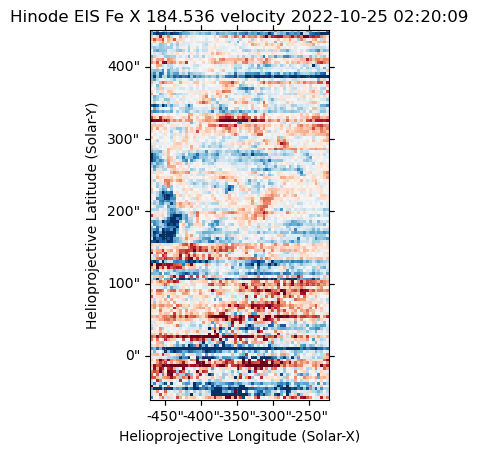

In [140]:
eis_auto_fit_184_velmap.plot()

In [141]:
eis_auto_fit_184_velmap_shift = eis_auto_fit_184_velmap.shift_reference_coord(eis_to_aia_Txshift, eis_to_aia_Tyshift)
with propagate_with_solar_surface(rotation_model="rigid"):
    eis_auto_fit_184_velmap_shift_derot = eis_auto_fit_184_velmap_shift.reproject_to(aia_193_map_crop.wcs)

eis_auto_fit_184_velmap_shift_derot_repro = eis_auto_fit_184_velmap_shift_derot.reproject_to(fsi_304_crop_shift.wcs)
eis_auto_fit_184_velmap_shift_derot_repro_hrifov = eis_auto_fit_184_velmap_shift_derot_repro.reproject_to(hri_174_map_shifted_toaia.wcs)

INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]
INFO: Missing metadata for solar radius: assuming the standard radius of the photosphere. [sunpy.map.mapbase]


/home/yjzhu/.local/lib/python3.11/site-packages/astropy/visualization/wcsaxes/patches.py:196: UserWarning: Setting the 'color' property will override the edgecolor or facecolor properties.
  super().__init__(vertices, **kwargs)


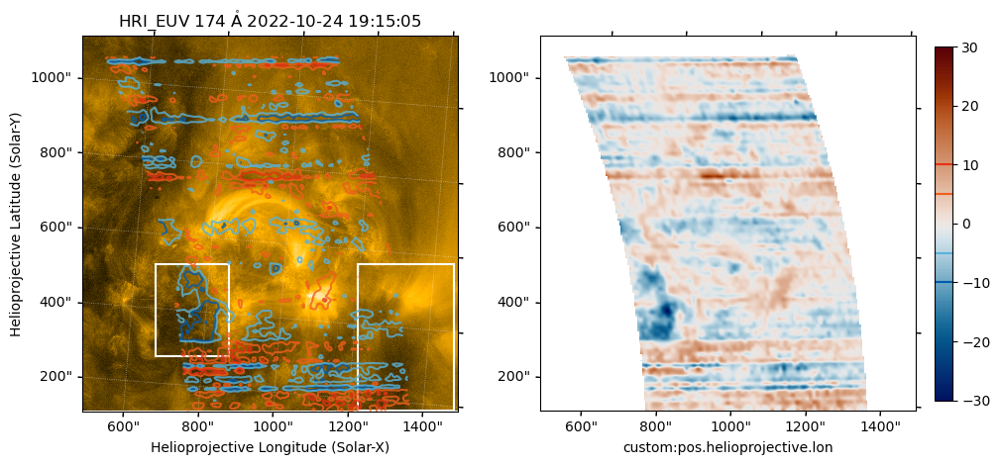

In [142]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()

eis_auto_fit_184_velmap_shift_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
    clb.ax.axhline(level_,color=color_)

bounds = ax1.axis()
hri_174_map_shifted_toaia.draw_quadrangle([400,300]*u.pix,top_right=[800,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
hri_174_map_shifted_toaia.draw_quadrangle([1500,0]*u.pix,top_right=[2029,800]*u.pix, 
                                    axes=ax1, color="w", lw=1.5)
ax1.axis(bounds)
ax2.set_ylabel(" ")

In [143]:
seed_pixels = np.where(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data < - 30)
seed_pixels_skycoord = eis_auto_fit_184_velmap_shift_derot_repro_hrifov.pixel_to_world(seed_pixels[1]*u.pix,seed_pixels[0]*u.pix)

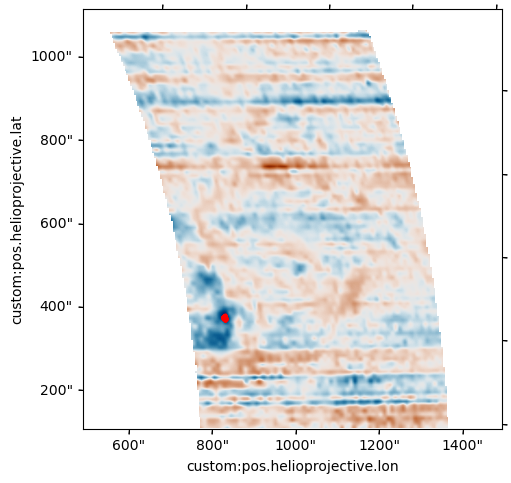

In [144]:
fig = plt.figure(figsize=(5,5),constrained_layout=True)
ax1 = fig.add_subplot(111,projection=hri_174_map_shifted_toaia)
im1 = ax1.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")

# ax1.scatter(seed_pixels[1],seed_pixels[0],color="r",s=1)
ax1.plot_coord(seed_pixels_skycoord,marker="o",markersize=2,linestyle="None",color="r")

In [145]:
vel_seed_FeX_184 = np.nanmean(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data[seed_pixels])
vel_seed_NeVIII_770 = np.nanmean(spice_NeVIII_velmap_derot_shift_hrifov.data[seed_pixels])

In [146]:
print(vel_seed_FeX_184, vel_seed_NeVIII_770)

-31.180016963686196 -35.01815653373054


In [147]:
hinode_observer = eis_195_intmap_shift.observer_coordinate
spice_observer = spice_NeVIII_intmap.observer_coordinate
hinode_observer_spice_frame = hinode_observer.transform_to(spice_observer.frame)
with propagate_with_solar_surface(rotation_model="rigid"):
    seed_pixel_coord0_spice_frame = seed_pixels_skycoord[0].transform_to(spice_observer.frame)

In [148]:
# return unit vector pointing from coord1 to coord2
def get_unit_vector(coord1,coord2):
    xyz = coord2.cartesian.xyz - coord1.cartesian.xyz
    return xyz/np.linalg.norm(xyz)

In [149]:
seed_pixel_coord0_spice_frame.cartesian.xyz/np.linalg.norm(seed_pixel_coord0_spice_frame.cartesian.xyz)

<Quantity [ 0.84139   , -0.47183579,  0.26350306]>

In [150]:
hinode_unit_vec = get_unit_vector(seed_pixel_coord0_spice_frame,hinode_observer_spice_frame).value

In [151]:
spice_unit_vec = get_unit_vector(seed_pixel_coord0_spice_frame,spice_observer).value

In [152]:
epipolar_plane_normvec = np.cross(hinode_unit_vec,spice_unit_vec)

In [153]:
angle_hinode_spice = np.arccos(np.dot(hinode_unit_vec,spice_unit_vec))*u.rad

In [154]:
matrix_A = np.array([hinode_unit_vec,spice_unit_vec,epipolar_plane_normvec])
vector_B = np.array([np.abs(vel_seed_FeX_184),np.abs(vel_seed_NeVIII_770),0])

vec_ep = np.linalg.solve(matrix_A,vector_B)

In [155]:
vec_ep

array([ 31.02313114, -19.57743934,   4.15088941])

In [156]:
vec_eq_mag = np.linalg.norm(vec_ep)

In [157]:
fake_vec_eq_xyz = seed_pixel_coord0_spice_frame.cartesian.xyz + vec_ep*0.005*const.R_sun

In [158]:
fake_vec_eq_coord = SkyCoord(fake_vec_eq_xyz[0],fake_vec_eq_xyz[1],fake_vec_eq_xyz[2],frame=spice_observer.frame,
                             representation_type="cartesian").transform_to("heliographic_stonyhurst")

In [308]:
with propagate_with_solar_surface(rotation_model="rigid"):
    fake_vec_arrow_to_plot = astropy.coordinates.concatenate((fake_vec_eq_coord.transform_to(hri_174_map_shifted_toaia.coordinate_frame),
                                                            seed_pixel_coord0_spice_frame.transform_to(hri_174_map_shifted_toaia.coordinate_frame)))

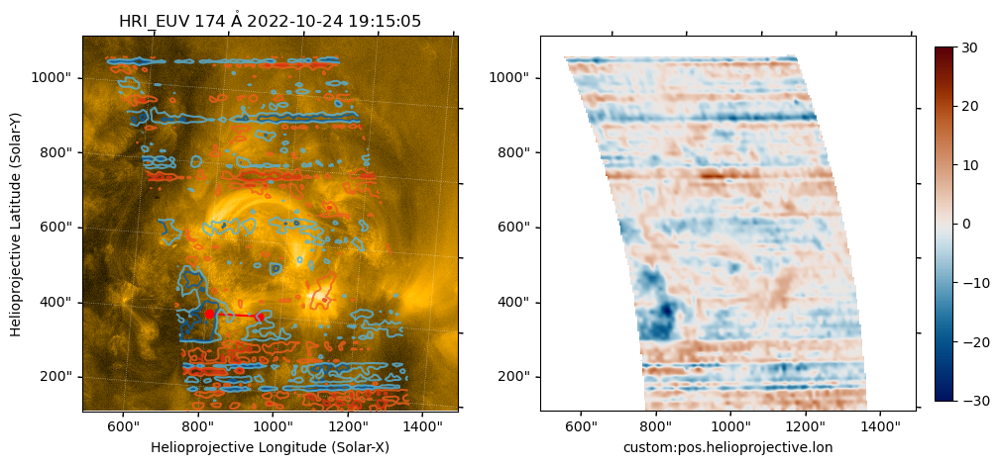

In [312]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=hri_174_map_shifted_toaia)
im1 = hri_174_map_shifted_toaia.plot()
ax1.plot_coord(fake_vec_arrow_to_plot,marker="o",linestyle="-",color="r")

eis_auto_fit_184_velmap_shift_derot_repro_hrifov.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax1,alpha=0.8)

ax2 = fig.add_subplot(122,projection=hri_174_map_shifted_toaia)
im2 = ax2.imshow(eis_auto_fit_184_velmap_shift_derot_repro_hrifov.data,vmin=-30,vmax=30,cmap=cmcm.vik,origin="lower")
clb = plt.colorbar(im2,ax=ax2,shrink=0.8)
# for level_, color_ in zip([-10,-5,5,10],["#005CAF","#58B2DC","#F05E1C","#E83015"]):
#     clb.ax.axhline(level_,color=color_)


ax2.set_ylabel(" ")

In [161]:
def coord_to_heexy(coord,hee_frame):
    coord = coord.transform_to(hee_frame)
    coord.representation_type = 'cartesian'
    return coord.y.to_value('AU'), coord.x.to_value('AU')

In [162]:
def get_first_orbit(coord,hee_frame):
    lon = coord.transform_to(hee_frame).spherical.lon
    shifted = astropy.coordinates.Longitude(lon - lon[0])
    ends = np.flatnonzero(np.diff(shifted) < 0)
    if ends.size > 0:
        return coord[:ends[0]+1]
    return coord

In [163]:
planets = ['Earth']
times = spice_observer.obstime + np.arange(700) * u.day
planet_coords = {planet: get_first_orbit(get_body_heliographic_stonyhurst(planet, times),spice_observer.frame)
                 for planet in planets}

In [164]:
missions = ['Parker Solar Probe', 'Solar Orbiter',]
mission_labels = {'Parker Solar Probe': 'PSP', 'Solar Orbiter': 'SO'}
mission_coords = {mission: get_first_orbit(get_horizons_coord(mission, {'start': spice_observer.obstime,
                                                                        'stop': spice_observer.obstime + 1.2 * u.yr,
                                                                        'step': '1d'}),spice_observer.frame)
                  for mission in missions}

INFO: Obtained JPL HORIZONS location for Parker Solar Probe (spacecraft) [sunpy.coordinates.ephemeris]
INFO: Obtained JPL HORIZONS location for Solar Orbiter (spacecraft) (-144 [sunpy.coordinates.ephemeris]


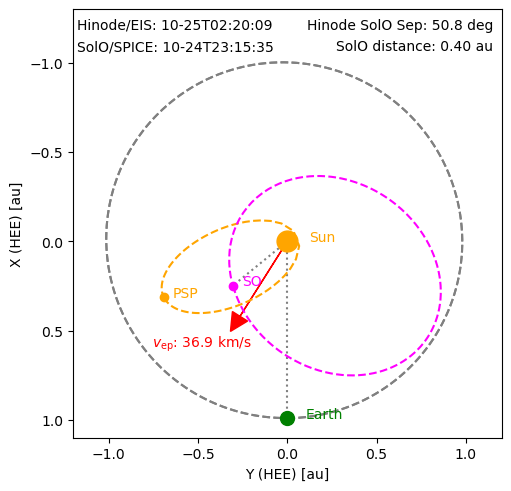

In [165]:
fig, ax = plt.subplots(figsize=(5,5),constrained_layout=True)

ax.set_xlim(-1.2, 1.2)
ax.set_ylim(1.1, -1.3)
ax.set_aspect('equal')
ax.plot([0, 0], [0, 1], linestyle='dotted', color='gray')

for planet, coord in planet_coords.items():
    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color='gray')

    if planet == 'Earth':
        color, markersize, offset = 'lime', 10, 0.1
    else:
        color, markersize, offset = 'gray', None, 0.05

for mission, coord in mission_coords.items():
    color = 'magenta' if mission == 'Solar Orbiter' else 'orange'

    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color=color)

    x, y = coord_to_heexy(coord[0],spice_observer.frame)
    if mission == 'Solar Orbiter':
        ax.plot([0, 1*x], [0, 1*y], linestyle='dotted', color='gray')
    ax.plot(x, y, 'o', color=color)

    ax.text(x + 0.05, y, mission_labels[mission], color=color)

for planet, coord in planet_coords.items():
    ax.plot(*coord_to_heexy(coord,spice_observer.frame), linestyle='dashed', color='gray')

    if planet == 'Earth':
        color, markersize, offset = 'green', 10, 0.1
    else:
        color, markersize, offset = 'gray', None, 0.05

    x, y = coord_to_heexy(coord[0],spice_observer.frame)
    ax.plot(x, y, 'o', markersize=markersize, color=color)
    ax.text(x + offset, y, planet, color=color)

ax.plot(0, 0, 'o', markersize=15, color='orange')
ax.text(0.12, 0, 'Sun', color='orange')

ax.set_xlabel('Y (HEE) [au]')
ax.set_ylabel('X (HEE) [au]')

ax.text(0.98,0.98,f"Hinode SolO Sep: {angle_hinode_spice.to(u.deg).value:.1f} deg",transform=ax.transAxes,ha="right",va="top")
ax.text(0.98,0.93,f"SolO distance: {spice_observer.radius.to(u.au).value:.2f} au",transform=ax.transAxes,ha="right",va="top")
ax.text(0.3,0.22,r"$v_{{\rm ep}}$: {:.1f} km/s".format(np.linalg.norm(vec_ep)),transform=ax.transAxes,ha="center",va="center",
        color="red")

ax.text(0.01,0.98,f"Hinode/EIS: {hinode_observer.obstime.isot[5:-4]}",transform=ax.transAxes,ha="left",va="top")
ax.text(0.01,0.93,f"SolO/SPICE: {spice_observer.obstime.isot[5:-4]}",transform=ax.transAxes,ha="left",va="top")

ax.arrow(0, 0, vec_ep[1]/np.linalg.norm(vec_ep)/2, vec_ep[0]/np.linalg.norm(vec_ep)/2, head_width=0.1, head_length=0.1, fc='r', ec='r')

plt.savefig("../../figs/test_figs/epipolar_velocity.png",dpi=300,bbox_inches="tight")

In [166]:
hri_174_map_shifted_toaia_all_coord = sunpy.map.all_coordinates_from_map(hri_174_map_shifted_toaia)

In [167]:
hri_174_map_shifted_toaia_all_coord = hri_174_map_shifted_toaia_all_coord.make_3d()

In [168]:
hri_174_map_shifted_toaia_all_coord_hee = hri_174_map_shifted_toaia_all_coord.transform_to(hri_174_map_shifted_toaia.observer_coordinate)

In [169]:
with propagate_with_solar_surface(rotation_model="rigid"):
    hri_174_map_shifted_toaia_all_coord_hee_spice = hri_174_map_shifted_toaia_all_coord_hee.transform_to(spice_observer.frame)

In [170]:
hri_174_map_shifted_toaia_3d_grid = pv.StructuredGrid(hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.x.to_value("AU"),
                                                      hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.y.to_value("AU"),
                                                     hri_174_map_shifted_toaia_all_coord_hee_spice.cartesian.z.to_value("AU"))

In [171]:
seed_pixel_coord0_spice_frame.cartesian.xyz.to_value("AU")

array([ 0.00391286, -0.00219426,  0.00122541])

In [ ]:
# pv_plotter = pv.Plotter(notebook=True)

# hri_174_map_shifted_toaia_3d_norm = ImageNormalize(vmin=0,vmax=1.5e4,stretch=AsinhStretch(0.05))
# pv_plotter.add_mesh(hri_174_map_shifted_toaia_3d_grid,scalars=hri_174_map_shifted_toaia_3d_norm(hri_174_map_shifted_toaia.data), cmap="solar orbiterhri_euv174")
# pv_plotter.add_arrows(seed_pixel_coord0_spice_frame.cartesian.xyz.to_value("AU"),vec_ep, mag=1e-5,color="lime")
# pv_plotter.add_axes(line_width=5, labels_off=False)
# pv_plotter.show()
# pv_plotter.export_vtksz("../../figs/test_figs/hri_174_map_shifted_toaia_3d.vtksz")

# del pv_plotter


In [302]:
with fits.open("../../src/CHASE/20221024/RSM20221024T191230_0022_HA.fits") as hdul:
    hdul.info()
    chase_header = deepcopy(hdul[1].header)
    chase_halpha_core_data = hdul[1].data[68,:,:]
    chase_halpha_blue_wing_data = hdul[1].data[45,:,:]
    chase_SiI_core_data = hdul[1].data[3,:,:]
    average_halpha_profile = np.nanmean(hdul[1].data[:,:,:],axis=(1,2))

Filename: ../../src/CHASE/20221024/RSM20221024T191230_0022_HA.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU       4   ()      
  1  COMPRESSED_IMAGE    1 CompImageHDU     48   (2304, 2313, 118)   int16   


In [274]:
chase_header

XTENSION= 'IMAGE   '           / binary table extension                         
BITPIX  =                   16 / data type of original image                    
NAXIS   =                    3 / Number of data axes                            
NAXIS1  =                 2304 / Length of data axis 1 (slit dimension)         
NAXIS2  =                 2313 / Length of data axis 2 (scanning steps)         
NAXIS3  =                  118 / Length of data axis 3 (wavelength dimension)   
PCOUNT  =                    0 / number of group parameters                     
GCOUNT  =                    1 / number of groups                               
TELESCOP= 'CHASE-HIS'          / Telescop Name                                  
BIN     =                    2 / Binning mode                                   
DATE_OBS= '2022-10-24T19:12:30' / Observation time                              
CRPIX1  =               1151.5 / X coordinate of solar center in pixel          
CUNIT1  = 'arcsec  '        

In [275]:
chase_fits_header = sunpy.map.make_fitswcs_header(chase_halpha_core_data.shape,
                                                  SkyCoord(chase_header["CRVAL1"]*u.arcsec,chase_header["CRVAL2"]*u.arcsec,
                                                           obstime=chase_header["DATE_OBS"],observer="Earth",frame="helioprojective"),
                                                  reference_pixel=[chase_header["CRPIX1"],chase_header["CRPIX2"]]*u.pix,
                                                  scale=u.Quantity([0.5218*2,0.5218*2],u.arcsec/u.pix),
                                                  rotation_angle=-chase_header["INST_ROT"]*u.deg,
                                                  telescope="CHASE",instrument="RSM")

In [294]:
chase_wavelength = (np.arange(chase_header["NAXIS3"]) + 1 - (chase_header["CRPIX3"] + 1))*chase_header["CDELT3"] + chase_header["CRVAL3"]
# it seems that the crpix3 is 0, which is not consistent with the FITS index starting from 1
# so I will add 1 to the crpix3

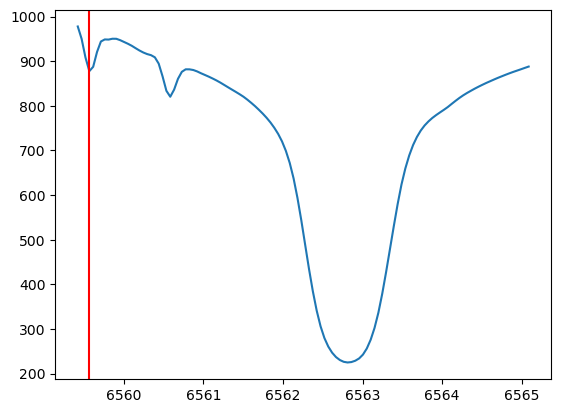

In [301]:
plt.plot(chase_wavelength,average_halpha_profile)
plt.axvline(chase_wavelength[3],color="r")


(<matplotlib.patches.Circle at 0x7f72ed919a50>, None)

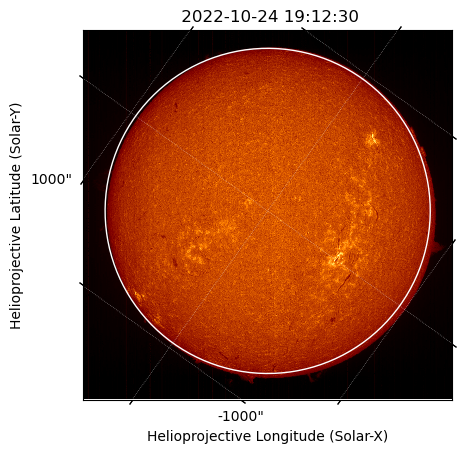

In [307]:
chase_halpha_core_map = sunpy.map.Map(np.nan_to_num(chase_halpha_core_data,nan=0).astype(np.float32),chase_fits_header)
chase_halpha_core_map = chase_halpha_core_map.submap([100,100]*u.pix,top_right=[2200,2200]*u.pix)
chase_halpha_core_map.plot_settings['cmap'] = "afmhot"
chase_halpha_core_map.plot()
chase_halpha_core_map.draw_limb()


(<matplotlib.patches.Circle at 0x7f72ed9703d0>, None)

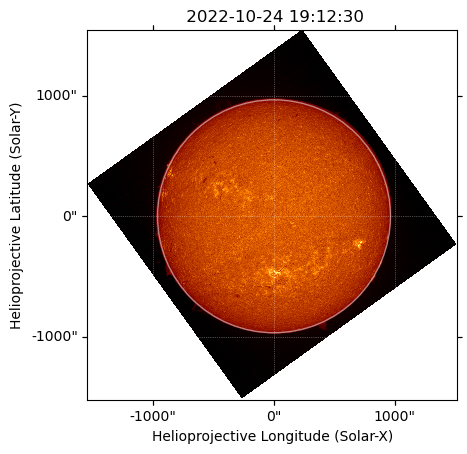

In [323]:
chase_halpha_core_map_north = chase_halpha_core_map.rotate().shift_reference_coord(5*u.arcsec,25*u.arcsec)
chase_halpha_core_map_north.plot()
chase_halpha_core_map_north.draw_limb(alpha=0.5)

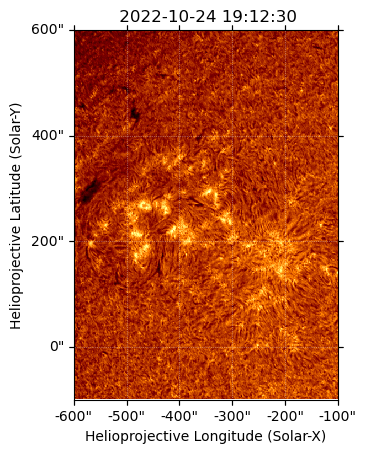

In [324]:
chase_halpha_core_map_crop = chase_halpha_core_map_north.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=chase_halpha_core_map_north.coordinate_frame),
                                                                top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=chase_halpha_core_map_north.coordinate_frame))
chase_halpha_core_map_crop.plot()

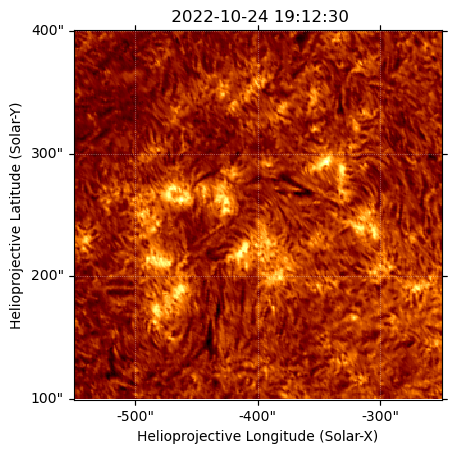

In [381]:
chase_halpha_core_map_align = chase_halpha_core_map_crop.submap(SkyCoord(-550*u.arcsec,100*u.arcsec,frame=chase_halpha_core_map_crop.coordinate_frame),
                                                                top_right=SkyCoord(-250*u.arcsec,400*u.arcsec,frame=chase_halpha_core_map_crop.coordinate_frame))
chase_halpha_core_map_align.plot()

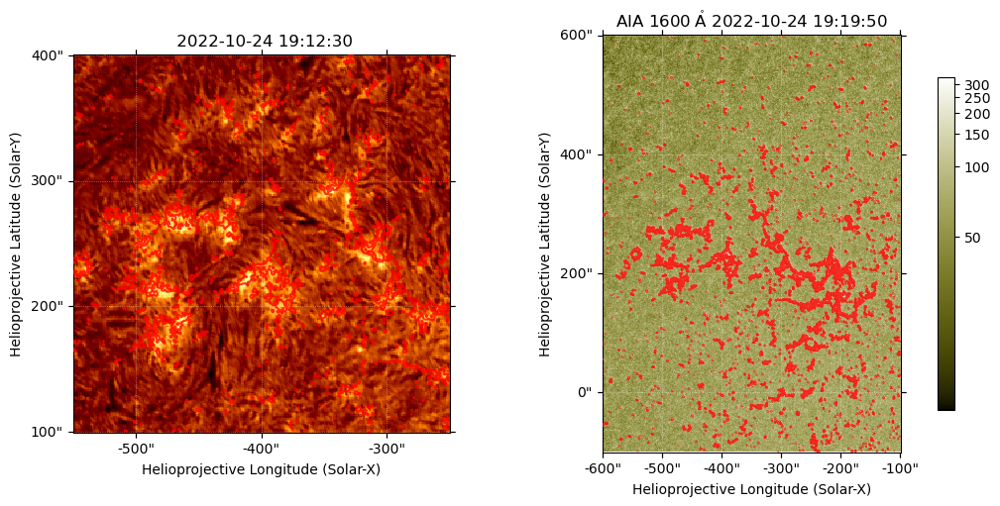

In [382]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align)
im1 = chase_halpha_core_map_align.plot()

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = aia_1600_map_crop.plot()
plt.colorbar(im2,ax=ax2,shrink=0.8)

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_map_crop.draw_contours(levels=[120]*aia_1600_map_crop.unit,colors=["r"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

In [383]:
aia_1600_resample_nx = (aia_1600_map_crop.scale.axis1 * aia_1600_map_crop.dimensions.x).to(u.arcsec) / chase_halpha_core_map_align.scale.axis1
aia_1600_resample_ny = (aia_1600_map_crop.scale.axis2 * aia_1600_map_crop.dimensions.y).to(u.arcsec) / chase_halpha_core_map_align.scale.axis2
aia_1600_map_crop_resample = aia_1600_map_crop.resample(u.Quantity([aia_1600_resample_nx, aia_1600_resample_ny]))
Txshift_chase_aia, Tyshift_chase_aia = coalign_shift(aia_1600_map_crop_resample,chase_halpha_core_map_align)
print(Txshift_chase_aia, Tyshift_chase_aia)

2.69367 arcsec 4.25398 arcsec


In [384]:
chase_halpha_core_map_align_shift = chase_halpha_core_map_align.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
aia_1600_map_crop_chase_halpha_fov = aia_1600_map_crop.reproject_to(chase_halpha_core_map_align_shift.wcs)

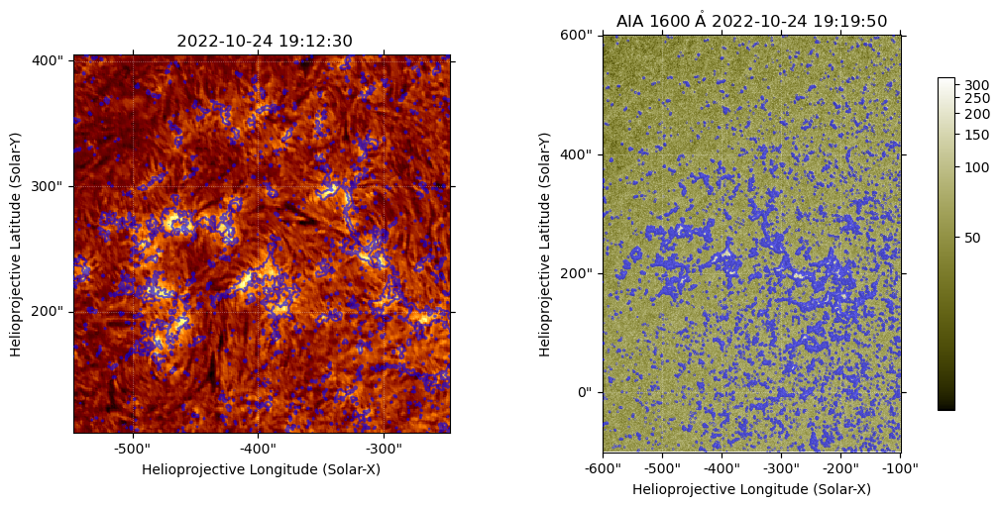

In [385]:
fig = plt.figure(figsize=(10,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()

ax2 = fig.add_subplot(122,projection=aia_1600_map_crop)
im2 = aia_1600_map_crop.plot()
plt.colorbar(im2,ax=ax2,shrink=0.8)

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    aia_1600_map_crop.draw_contours(levels=[100]*aia_1600_map_crop.unit,colors=["b"],axes=ax_,alpha=0.6)
    ax_.axis(bounds)

In [386]:
SunBlinker(aia_1600_map_crop_chase_halpha_fov, chase_halpha_core_map_align_shift)

In [395]:
chase_halpha_line_width_map = sunpy.map.Map("../../src/CHASE/20221024/RSM20221024T191230_0022_HA_linewidth.fits")
chase_halpha_line_width_map.plot_settings['cmap'] = "plasma"
chase_halpha_line_width_map.plot_settings['norm'] = ImageNormalize(vmin=0.9,vmax=1.35)

In [396]:
chase_halpha_line_width_map_north = chase_halpha_line_width_map.rotate().shift_reference_coord(5*u.arcsec,25*u.arcsec)
chase_halpha_line_width_map_crop = chase_halpha_line_width_map_north.submap(SkyCoord(-600*u.arcsec,-100*u.arcsec,frame=chase_halpha_line_width_map_north.coordinate_frame),
                                                                top_right=SkyCoord(-100*u.arcsec,600*u.arcsec,frame=chase_halpha_line_width_map_north.coordinate_frame))
chase_halpha_line_width_map_crop_shift = chase_halpha_line_width_map_crop.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
chase_halpha_line_width_map_align = chase_halpha_line_width_map_crop_shift.submap(SkyCoord(-550*u.arcsec,100*u.arcsec,frame=chase_halpha_line_width_map_crop_shift.coordinate_frame),
                                                                top_right=SkyCoord(-250*u.arcsec,400*u.arcsec,frame=chase_halpha_line_width_map_crop_shift.coordinate_frame))
chase_halpha_line_width_map_align_shift = chase_halpha_line_width_map_align.shift_reference_coord(Txshift_chase_aia,Tyshift_chase_aia)
                                                                                 

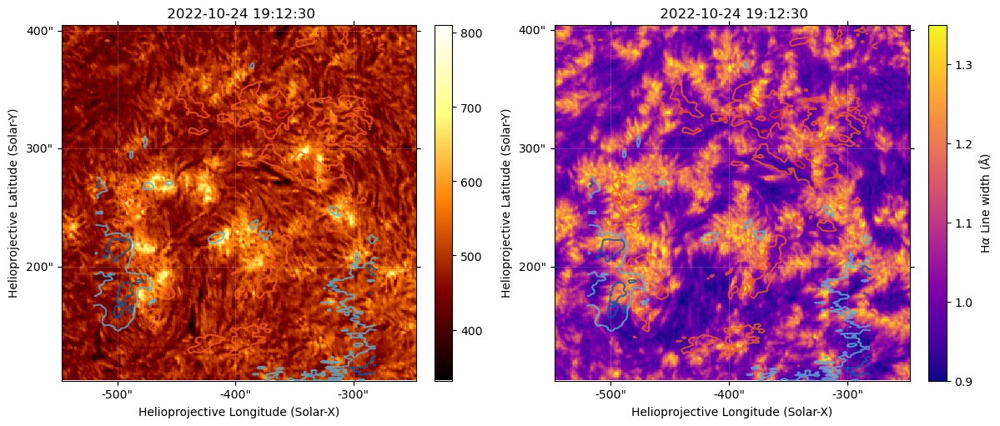

In [397]:
fig = plt.figure(figsize=(12,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()
clb1 = plt.colorbar(im1,ax=ax1,shrink=1)

ax2 = fig.add_subplot(122,projection=chase_halpha_line_width_map_align_shift)
im2 = chase_halpha_line_width_map_align_shift.plot()
clb2 = plt.colorbar(im2,ax=ax2,shrink=1)
clb2.set_label(r"H$\alpha$ Line width (Å)")

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    eis_195_velmap_derot.draw_contours(levels=[-10,-5,5,10],colors=["#005CAF","#58B2DC","#F05E1C","#E83015"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)

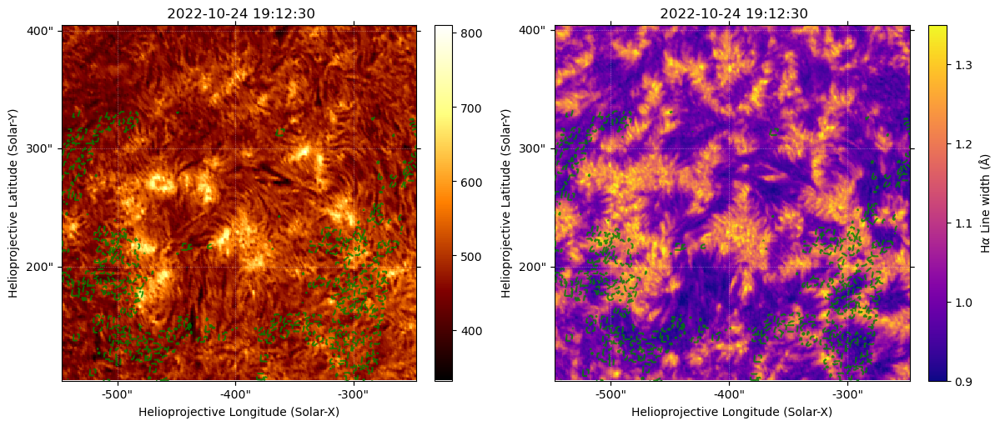

In [398]:
fig = plt.figure(figsize=(12,5),constrained_layout=True)

ax1 = fig.add_subplot(121,projection=chase_halpha_core_map_align_shift)
im1 = chase_halpha_core_map_align_shift.plot()
clb1 = plt.colorbar(im1,ax=ax1,shrink=1)

ax2 = fig.add_subplot(122,projection=chase_halpha_line_width_map_align_shift)
im2 = chase_halpha_line_width_map_align_shift.plot()
clb2 = plt.colorbar(im2,ax=ax2,shrink=1)
clb2.set_label(r"H$\alpha$ Line width (Å)")

for ax_ in (ax1,ax2):
    bounds = ax_.axis()
    spice_NeVIII_velmap_derot_shift_hrifov.draw_contours(levels=[-40],colors=["green"],axes=ax_,alpha=0.8)
    ax_.axis(bounds)